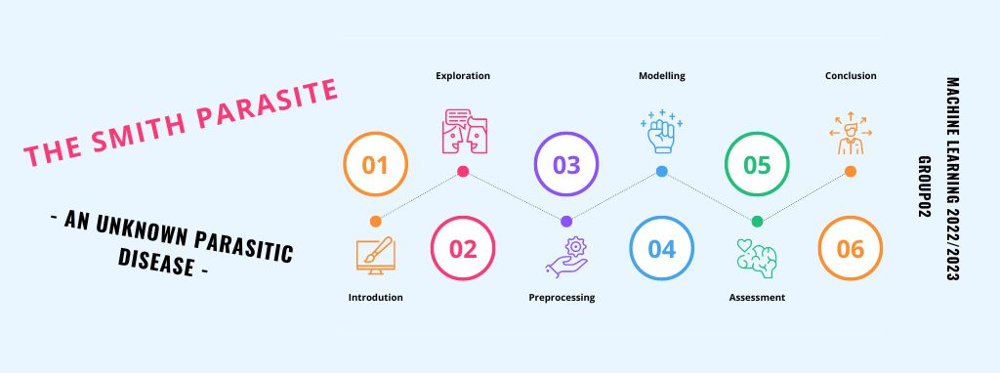

## Table of Contents

* [1. Introduction](#chapter1)
    * [1.1. Problem Statement](#section_1_1)
    * [1.2. Set up the environment](#section_1_2)
        
* [2. Exploration](#chapter2)
    * [2.1. Import data sets](#section_2_1)
        * [Sociodemographic Data 2.1.1](#section_2_1_1)
        * [Habits related Data 2.1.2](#section_2_1_2)
        * [Health Related Data 2.1.3](#section_2_1_3)
    * [2.2. Review data sets](#section_2_2)
        * [Sociodemographic Data 2.2.1](#section_2_2_1)
        * [Habits related Data 2.2.2](#section_2_2_2)
        * [Health Related Data 2.2.3](#section_2_2_3)
    * [2.3. Initial Train Data Set](#section_2_3)
        * [Combine Train Data Sets 2.3.1](#section_2_3_1)
        * [Review Initial Data Set 2.3.2](#section_2_3_2)
        * [Handling Features 2.3.3](#section_2_3_3)
        * [Create a Copy 2.3.4](#section_2_3_4)
    * [2.4. Exploratory Data Analysis](#section_2_4)
        * [Identifying Variables 2.4.1](#section_2_4_1)
        * [Univariate Analysis 2.4.2](#section_2_4_2)
        * [Bivariate Analysis 2.4.3](#section_2_4_3)
        * [Multivariate Analysis 2.4.4](#section_2_4_4)

* [3. Preprocessing](#chapter3)
    * [Section 3.1](#section_3_1)
        * [Sub Section 3.1.1](#section_3_1_1)
        * [Sub Section 3.1.2](#section_3_1_2)
    * [Section 3.2](#section_3_2)
        * [Sub Section 3.2.1](#section_3_2_1)
        * [Sub Section 3.2.2](#section_3_2_2)

* [4. Modelling](#chapter4)
* [5. Assessment](#chapter5)
* [6. Conclusion](#chapter6)

<div class="alert alert-block alert-success">
<a class="anchor" id="chapter1">     

## 1. Introduction 
</a> 

</div>


### 1.1. Problem Statement <a class="anchor" id="section_1_1"></a>

xxxxxxxxxxxxxxxxxxxxxxxxxx
xxxxxxxxxxxxxxxxxxxxxxxxxx
xxxxxxxxxxxxxxxxxxxxxxxxx
xxxxxxxxxxxxxxxxxxxxxxxxx

  

### 1.2. Set up the environment <a class="anchor" id="section_1_2"></a>


In [69]:
# Upload libraries - Example

# to handle data set
import pandas as pd
import numpy as np

# to plot
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib.cbook import boxplot_stats
from matplotlib.pyplot import figure
from matplotlib.lines import Line2D
import matplotlib.gridspec as gridspec
import seaborn as sns
import textwrap
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px



from sklearn.model_selection import train_test_split
from sklearn.feature_selection import chi2
from sklearn.feature_selection import SelectKBest
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import MinMaxScaler
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import LabelEncoder
from sklearn.compose import make_column_selector as selector
from sklearn.pipeline import Pipeline

# Statistics
from scipy.stats import skew
from scipy.stats import boxcox

# Time
from datetime import date

# Diplay Html Tables
from IPython.display import display, HTML
from tabulate import tabulate


<div class="alert alert-block alert-success">
<a class="anchor" id="chapter2">     

## 2. Exploration
</a> 

</div>


### 2.1. Import data sets <a class="anchor" id="section_2_1"></a>

#### 2.1.1. Sociodemographic Data <a class="anchor" id="section_2_1_1"></a>

In [2]:
df_demo = pd.read_excel(r'./../Data/train_demo.xlsx')

#### 2.1.2. Habits Data <a class="anchor" id="section_2_1_2"></a>

In [3]:
df_habits = pd.read_excel(r'./../Data/train_habits.xlsx')

#### 2.1.3. Health Related Data <a class="anchor" id="section_2_1_3"></a>

In [4]:
df_health = pd.read_excel(r'./../Data/train_health.xlsx')

### 2.2. Review data sets <a class="anchor" id="section_2_2"></a>

#### 2.2.1. Sociodemographic Data <a class="anchor" id="section_2_2_1"></a>

In [5]:
print ('The Sociodemographic dataset has {} rows and {} columns.'.format(df_demo.shape[0],df_demo.shape[1]))
df_demo.head(10)

The Sociodemographic dataset has 800 rows and 6 columns.


,PatientID,Name,Birth_Year,Region,Education,Disease
0,1167,Mrs. Stephanie Gay,1965,London,High School Incomplete (10th to 11th grade),1
1,1805,Mr. Sherman Nero,1969,South West,High School Incomplete (10th to 11th grade),1
2,1557,Mr. Mark Boller,1974,Yorkshire and the Humber,Elementary School (1st to 9th grade),1
3,1658,Mr. David Caffee,1958,London,University Complete (3 or more years),0
4,1544,Mr. Gerald Emery,1968,South East,University Incomplete (1 to 2 years),1
5,1653,Mr. David Lamothe,1966,East Midlands,NaN,0
6,1422,Mrs. Patricia Byrne,1965,Yorkshire and the Humber,High School Graduate,1
7,1806,Mr. Wesley Shoemaker,1965,West Midlands,High School Graduate,0
8,1703,Mr. Billy Kirkland,1965,East of England,High School Graduate,1
9,1370,Mrs. Tina Morris,1979,East Midlands,High School Graduate,0


#### 2.2.2. Habits related Data <a class="anchor" id="section_2_2_2"></a>

In [6]:
print ('The habits dataset has {} rows and {} columns.'.format(df_habits.shape[0],df_habits.shape[1]))
df_habits.head(10)

The habits dataset has 800 rows and 6 columns.


,PatientID,Smoking_Habit,Drinking_Habit,Exercise,Fruit_Habit,Water_Habit
0,1167,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters
1,1805,No,I consider myself a social drinker,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters
2,1557,No,I consider myself a social drinker,No,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter
3,1658,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter
4,1544,No,I consider myself a social drinker,No,1 to 2 pieces of fruit in average,More than half a liter but less than one liter
5,1653,Yes,I consider myself a social drinker,Yes,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter
6,1422,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,Less than half a liter
7,1806,No,I consider myself a social drinker,Yes,1 to 2 pieces of fruit in average,More than half a liter but less than one liter
8,1703,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters
9,1370,Yes,I consider myself a social drinker,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters


#### 2.2.3. Health Related Data <a class="anchor" id="section_2_2_3"></a>

In [7]:
print ('The health dataset has {} rows and {} columns.'.format(df_health.shape[0],df_health.shape[1]))
df_health.head(10)

The health dataset has 800 rows and 9 columns.


,PatientID,Height,Weight,High_Cholesterol,Blood_Pressure,Mental_Health,Physical_Health,Checkup,Diabetes
0,1167,155,67,358,120,21,2,More than 3 years,Neither I nor my immediate family have diabetes.
1,1805,173,88,230,142,9,0,Not sure,Neither I nor my immediate family have diabetes.
2,1557,162,68,226,122,26,0,More than 3 years,Neither I nor my immediate family have diabetes.
3,1658,180,66,313,125,13,8,Not sure,I have/had pregnancy diabetes or borderline di...
4,1544,180,58,277,125,18,2,More than 3 years,I have/had pregnancy diabetes or borderline di...
5,1653,167,49,287,130,7,7,Not sure,Neither I nor my immediate family have diabetes.
6,1422,158,63,358,120,21,2,More than 3 years,Neither I nor my immediate family have diabetes.
7,1806,178,67,280,150,9,2,Less than 3 years but more than 1 year,Neither I nor my immediate family have diabetes.
8,1703,162,63,205,110,12,7,Less than 3 years but more than 1 year,Neither I nor my immediate family have diabetes.
9,1370,154,51,345,132,14,14,Not sure,Neither I nor my immediate family have diabetes.


### 2.3. Initial Train Data Set <a class="anchor" id="section_2_3"></a>

#### 2.3.1 Combine Train Data Sets <a class="anchor" id="section_2_3_1"></a>

In [8]:
df = pd.concat(
    objs=(iDF.set_index('PatientID') for iDF in (df_demo, df_habits, df_health)),
    axis=1, 
    join='inner'
).reset_index()

##### 2.3.2 Review Initial Data Set <a class="anchor" id="section_2_3_2"></a>

In [9]:
print ('The combined dataset has {} rows and {} columns.'.format(df.shape[0],df.shape[1]))


The combined dataset has 800 rows and 19 columns.


In [10]:
df.head(5)

,PatientID,Name,Birth_Year,Region,Education,Disease,Smoking_Habit,Drinking_Habit,Exercise,Fruit_Habit,Water_Habit,Height,Weight,High_Cholesterol,Blood_Pressure,Mental_Health,Physical_Health,Checkup,Diabetes
0,1167,Mrs. Stephanie Gay,1965,London,High School Incomplete (10th to 11th grade),1,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,155,67,358,120,21,2,More than 3 years,Neither I nor my immediate family have diabetes.
1,1805,Mr. Sherman Nero,1969,South West,High School Incomplete (10th to 11th grade),1,No,I consider myself a social drinker,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,173,88,230,142,9,0,Not sure,Neither I nor my immediate family have diabetes.
2,1557,Mr. Mark Boller,1974,Yorkshire and the Humber,Elementary School (1st to 9th grade),1,No,I consider myself a social drinker,No,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,162,68,226,122,26,0,More than 3 years,Neither I nor my immediate family have diabetes.
3,1658,Mr. David Caffee,1958,London,University Complete (3 or more years),0,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,180,66,313,125,13,8,Not sure,I have/had pregnancy diabetes or borderline di...
4,1544,Mr. Gerald Emery,1968,South East,University Incomplete (1 to 2 years),1,No,I consider myself a social drinker,No,1 to 2 pieces of fruit in average,More than half a liter but less than one liter,180,58,277,125,18,2,More than 3 years,I have/had pregnancy diabetes or borderline di...


In [11]:
# Dimensions of data set and types of each attribute
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 800 entries, 0 to 799
Data columns (total 19 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   PatientID         800 non-null    int64 
 1   Name              800 non-null    object
 2   Birth_Year        800 non-null    int64 
 3   Region            800 non-null    object
 4   Education         787 non-null    object
 5   Disease           800 non-null    int64 
 6   Smoking_Habit     800 non-null    object
 7   Drinking_Habit    800 non-null    object
 8   Exercise          800 non-null    object
 9   Fruit_Habit       800 non-null    object
 10  Water_Habit       800 non-null    object
 11  Height            800 non-null    int64 
 12  Weight            800 non-null    int64 
 13  High_Cholesterol  800 non-null    int64 
 14  Blood_Pressure    800 non-null    int64 
 15  Mental_Health     800 non-null    int64 
 16  Physical_Health   800 non-null    int64 
 17  Checkup         

In [12]:
# Unique values for categorical Variables (without 'Name' Variable)
for col in df:
    if pd.api.types.infer_dtype(df[col])=='string' and col!='Name':
        list = df[col].unique() # Visualization 1 row
        display(tabulate([list], headers= [col], tablefmt='html')) # Visualization 1 row

,,,,,,,,,Region
London,South West,Yorkshire and the Humber,South East,East Midlands,West Midlands,East of England,North West,North East,LONDON


,,,,,,Education
High School Incomplete (10th to 11th grade),Elementary School (1st to 9th grade),University Complete (3 or more years),University Incomplete (1 to 2 years),nan,High School Graduate,I never attended school / Other


,Smoking_Habit
No,Yes


,,Drinking_Habit
I usually consume alcohol every day,I consider myself a social drinker,I do not consume any type of alcohol


,Exercise
Yes,No


,,,,Fruit_Habit
Less than 1. I do not consume fruits every day.,1 to 2 pieces of fruit in average,3 to 4 pieces of fruit in average,5 to 6 pieces of fruit in average,More than six pieces of fruit


,,Water_Habit
Between one liter and two liters,More than half a liter but less than one liter,Less than half a liter


,,,Checkup
More than 3 years,Not sure,Less than 3 years but more than 1 year,Less than three months


,,,Diabetes
Neither I nor my immediate family have diabetes.,I have/had pregnancy diabetes or borderline diabetes,I do have diabetes,"I don't have diabetes, but I have direct family members who have diabetes."


#### 2.3.3 Handling Features <a class="anchor" id="section_2_3_3"></a>

##### a) Categorical Features

In [13]:
# Format PatientId
df['PatientID']=df['PatientID'].astype('object')
df['Disease']=df['Disease'].astype('object')

In [14]:
# regions London, the North East, North West, Yorkshire, East Midlands, West Midlands, South East, East of England and the South West

df['Region'].replace('LONDON','London', inplace=True)

df.Region.unique()

array(['London', 'South West', 'Yorkshire and the Humber', 'South East',
       'East Midlands', 'West Midlands', 'East of England', 'North West',
       'North East'], dtype=object)

In [15]:
# Extract information from Name (Family Name and Gender)
df['Surname']=df['Name'].str.split(" ").map(lambda x: x[-1])

df['Gender'] = df['Name'].str.split(n=1).str[0]

df['Gender'].replace(['Mr.','Mrs.'], ['Male','Female'],inplace=True)

df.drop('Name', inplace=True, axis=1)

###### b) Numeric Features

In [16]:
today = date.today()

df['Age']= today.year - df['Birth_Year'] 

df.drop('Birth_Year', inplace=True, axis=1)

In [17]:
df['BMI'] = round(df['Weight']/((df['Height']/100)**2),1)

df['BMI'].head()

0    27.9
1    29.4
2    25.9
3    20.4
4    17.9
Name: BMI, dtype: float64

In [18]:
def convert_bmi_to_description(x):
    if x['BMI'] < 18.5:
        return 'Underweight'
    elif x['BMI'] < 25:
        return 'Normal'
    elif x['BMI'] < 30:
        return 'Overweight'
    elif x['BMI'] <35:
        return 'Obesity'
    elif x['BMI'] >=35:
        return 'Extreme Obesity'

df['BMI_Status'] = df.apply(convert_bmi_to_description,axis=1)
df.head()

,PatientID,Region,Education,Disease,Smoking_Habit,Drinking_Habit,Exercise,Fruit_Habit,Water_Habit,Height,...,Blood_Pressure,Mental_Health,Physical_Health,Checkup,Diabetes,Surname,Gender,Age,BMI,BMI_Status
0,1167,London,High School Incomplete (10th to 11th grade),1,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,155,...,120,21,2,More than 3 years,Neither I nor my immediate family have diabetes.,Gay,Female,57,27.9,Overweight
1,1805,South West,High School Incomplete (10th to 11th grade),1,No,I consider myself a social drinker,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,173,...,142,9,0,Not sure,Neither I nor my immediate family have diabetes.,Nero,Male,53,29.4,Overweight
2,1557,Yorkshire and the Humber,Elementary School (1st to 9th grade),1,No,I consider myself a social drinker,No,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,162,...,122,26,0,More than 3 years,Neither I nor my immediate family have diabetes.,Boller,Male,48,25.9,Overweight
3,1658,London,University Complete (3 or more years),0,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,180,...,125,13,8,Not sure,I have/had pregnancy diabetes or borderline di...,Caffee,Male,64,20.4,Normal
4,1544,South East,University Incomplete (1 to 2 years),1,No,I consider myself a social drinker,No,1 to 2 pieces of fruit in average,More than half a liter but less than one liter,180,...,125,18,2,More than 3 years,I have/had pregnancy diabetes or borderline di...,Emery,Male,54,17.9,Underweight


In [19]:
def convert_Blood_Pressure_to_description(x):
    if x['Blood_Pressure'] < 120:
        return 'Normal blood pressure'
    elif x['Blood_Pressure'] <130:
        return 'Elevated blood pressure'
    elif x['Blood_Pressure'] < 140:
        return 'Stage 1 high blood pressure (hypertension)'
    elif x['Blood_Pressure'] >=140:
        return 'Stage 2 high blood pressure (hypertension)'

df['Blood_Pressure_Status'] = df.apply(convert_Blood_Pressure_to_description,axis=1)
df.head()

,PatientID,Region,Education,Disease,Smoking_Habit,Drinking_Habit,Exercise,Fruit_Habit,Water_Habit,Height,...,Mental_Health,Physical_Health,Checkup,Diabetes,Surname,Gender,Age,BMI,BMI_Status,Blood_Pressure_Status
0,1167,London,High School Incomplete (10th to 11th grade),1,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,155,...,21,2,More than 3 years,Neither I nor my immediate family have diabetes.,Gay,Female,57,27.9,Overweight,Elevated blood pressure
1,1805,South West,High School Incomplete (10th to 11th grade),1,No,I consider myself a social drinker,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,173,...,9,0,Not sure,Neither I nor my immediate family have diabetes.,Nero,Male,53,29.4,Overweight,Stage 2 high blood pressure (hypertension)
2,1557,Yorkshire and the Humber,Elementary School (1st to 9th grade),1,No,I consider myself a social drinker,No,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,162,...,26,0,More than 3 years,Neither I nor my immediate family have diabetes.,Boller,Male,48,25.9,Overweight,Elevated blood pressure
3,1658,London,University Complete (3 or more years),0,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,180,...,13,8,Not sure,I have/had pregnancy diabetes or borderline di...,Caffee,Male,64,20.4,Normal,Elevated blood pressure
4,1544,South East,University Incomplete (1 to 2 years),1,No,I consider myself a social drinker,No,1 to 2 pieces of fruit in average,More than half a liter but less than one liter,180,...,18,2,More than 3 years,I have/had pregnancy diabetes or borderline di...,Emery,Male,54,17.9,Underweight,Elevated blood pressure


In [20]:
def convert_High_Cholesterol_to_description(x):
    if x['High_Cholesterol'] < 150:
        return 'Normal'
    elif x['High_Cholesterol'] <200:
        return 'Borderline high risk'
    elif x['High_Cholesterol'] < 500:
        return 'High risk'
    elif x['High_Cholesterol'] >=500:
        return 'Very high risk'

df['High_Cholesterol_Status'] = df.apply(convert_High_Cholesterol_to_description,axis=1)
df.head()

,PatientID,Region,Education,Disease,Smoking_Habit,Drinking_Habit,Exercise,Fruit_Habit,Water_Habit,Height,...,Physical_Health,Checkup,Diabetes,Surname,Gender,Age,BMI,BMI_Status,Blood_Pressure_Status,High_Cholesterol_Status
0,1167,London,High School Incomplete (10th to 11th grade),1,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,155,...,2,More than 3 years,Neither I nor my immediate family have diabetes.,Gay,Female,57,27.9,Overweight,Elevated blood pressure,High risk
1,1805,South West,High School Incomplete (10th to 11th grade),1,No,I consider myself a social drinker,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,173,...,0,Not sure,Neither I nor my immediate family have diabetes.,Nero,Male,53,29.4,Overweight,Stage 2 high blood pressure (hypertension),High risk
2,1557,Yorkshire and the Humber,Elementary School (1st to 9th grade),1,No,I consider myself a social drinker,No,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,162,...,0,More than 3 years,Neither I nor my immediate family have diabetes.,Boller,Male,48,25.9,Overweight,Elevated blood pressure,High risk
3,1658,London,University Complete (3 or more years),0,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,180,...,8,Not sure,I have/had pregnancy diabetes or borderline di...,Caffee,Male,64,20.4,Normal,Elevated blood pressure,High risk
4,1544,South East,University Incomplete (1 to 2 years),1,No,I consider myself a social drinker,No,1 to 2 pieces of fruit in average,More than half a liter but less than one liter,180,...,2,More than 3 years,I have/had pregnancy diabetes or borderline di...,Emery,Male,54,17.9,Underweight,Elevated blood pressure,High risk


In [21]:
#children (0-11), youth (12-24), young adults (25-54), middle-aged adults (55-74) and elderly (75+)'
def convert_Age_to_description(x):
    if x['Age'] < 12:
        return 'Children'
    elif x['Age'] < 25:
        return 'Youth'
    elif x['Age'] < 55:
        return 'Young adult'
    elif x['Age'] < 75:
        return 'Middle-aged adult'
    elif x['Age'] >= 75:
        return 'Elderly'

df['Age_Status'] = df.apply(convert_Age_to_description,axis=1)
df.head()


,PatientID,Region,Education,Disease,Smoking_Habit,Drinking_Habit,Exercise,Fruit_Habit,Water_Habit,Height,...,Checkup,Diabetes,Surname,Gender,Age,BMI,BMI_Status,Blood_Pressure_Status,High_Cholesterol_Status,Age_Status
0,1167,London,High School Incomplete (10th to 11th grade),1,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,155,...,More than 3 years,Neither I nor my immediate family have diabetes.,Gay,Female,57,27.9,Overweight,Elevated blood pressure,High risk,Middle-aged adult
1,1805,South West,High School Incomplete (10th to 11th grade),1,No,I consider myself a social drinker,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,173,...,Not sure,Neither I nor my immediate family have diabetes.,Nero,Male,53,29.4,Overweight,Stage 2 high blood pressure (hypertension),High risk,Young adult
2,1557,Yorkshire and the Humber,Elementary School (1st to 9th grade),1,No,I consider myself a social drinker,No,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,162,...,More than 3 years,Neither I nor my immediate family have diabetes.,Boller,Male,48,25.9,Overweight,Elevated blood pressure,High risk,Young adult
3,1658,London,University Complete (3 or more years),0,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,180,...,Not sure,I have/had pregnancy diabetes or borderline di...,Caffee,Male,64,20.4,Normal,Elevated blood pressure,High risk,Middle-aged adult
4,1544,South East,University Incomplete (1 to 2 years),1,No,I consider myself a social drinker,No,1 to 2 pieces of fruit in average,More than half a liter but less than one liter,180,...,More than 3 years,I have/had pregnancy diabetes or borderline di...,Emery,Male,54,17.9,Underweight,Elevated blood pressure,High risk,Young adult


##### c) Target Variable

In [22]:
# Move Target Variable for last column
target = 'Disease'
new_cols = [col for col in df.columns if col != target] + [target]
df = df[new_cols]

#### 2.3.4 Create a copy <a class="anchor" id="section_2_3_4"></a>

In [23]:
# Any changes made in the original DataFrame will not be reflected in the copy.
df_copy = df.copy()

In [24]:
df_copy.head()

,PatientID,Region,Education,Smoking_Habit,Drinking_Habit,Exercise,Fruit_Habit,Water_Habit,Height,Weight,...,Diabetes,Surname,Gender,Age,BMI,BMI_Status,Blood_Pressure_Status,High_Cholesterol_Status,Age_Status,Disease
0,1167,London,High School Incomplete (10th to 11th grade),No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,155,67,...,Neither I nor my immediate family have diabetes.,Gay,Female,57,27.9,Overweight,Elevated blood pressure,High risk,Middle-aged adult,1
1,1805,South West,High School Incomplete (10th to 11th grade),No,I consider myself a social drinker,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,173,88,...,Neither I nor my immediate family have diabetes.,Nero,Male,53,29.4,Overweight,Stage 2 high blood pressure (hypertension),High risk,Young adult,1
2,1557,Yorkshire and the Humber,Elementary School (1st to 9th grade),No,I consider myself a social drinker,No,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,162,68,...,Neither I nor my immediate family have diabetes.,Boller,Male,48,25.9,Overweight,Elevated blood pressure,High risk,Young adult,1
3,1658,London,University Complete (3 or more years),No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,180,66,...,I have/had pregnancy diabetes or borderline di...,Caffee,Male,64,20.4,Normal,Elevated blood pressure,High risk,Middle-aged adult,0
4,1544,South East,University Incomplete (1 to 2 years),No,I consider myself a social drinker,No,1 to 2 pieces of fruit in average,More than half a liter but less than one liter,180,58,...,I have/had pregnancy diabetes or borderline di...,Emery,Male,54,17.9,Underweight,Elevated blood pressure,High risk,Young adult,1


### 2.4. Exploratory Data Analysis <a class="anchor" id="section_2_4"></a>

#### 2.4.1. Identifying Variables <a class="anchor" id="section_2_4_1"></a>

Define each variable and its role in the dataset. 


##### a) Content Attributes

In [25]:
# Dimensions of data set and types of each attribute
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 800 entries, 0 to 799
Data columns (total 25 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   PatientID                800 non-null    object 
 1   Region                   800 non-null    object 
 2   Education                787 non-null    object 
 3   Smoking_Habit            800 non-null    object 
 4   Drinking_Habit           800 non-null    object 
 5   Exercise                 800 non-null    object 
 6   Fruit_Habit              800 non-null    object 
 7   Water_Habit              800 non-null    object 
 8   Height                   800 non-null    int64  
 9   Weight                   800 non-null    int64  
 10  High_Cholesterol         800 non-null    int64  
 11  Blood_Pressure           800 non-null    int64  
 12  Mental_Health            800 non-null    int64  
 13  Physical_Health          800 non-null    int64  
 14  Checkup                  8

In [26]:
ds_cat_stats = pd.DataFrame(columns = ['column', 'values', 'values_count_incna', 'values_count_nona', 
                                       'num_miss', 'pct_miss'])
tmp = pd.DataFrame()

for c in df.columns:
    tmp['column'] = [c]
    tmp['values'] = [df[c].unique()]
    tmp['values_count_incna'] = len(df[c].unique().tolist())
    tmp['values_count_nona'] = int(df[c].nunique())
    tmp['num_miss'] = df[c].isnull().sum()
    tmp['pct_miss'] = (df[c].isnull().sum()/ len(df)).round(3)*100
    ds_cat_stats = pd.concat([ds_cat_stats,tmp], ignore_index=True)

ds_cat_stats

,column,values,values_count_incna,values_count_nona,num_miss,pct_miss
0,PatientID,"[1167, 1805, 1557, 1658, 1544, 1653, 1422, 180...",800,800,0,0.0
1,Region,"[London, South West, Yorkshire and the Humber,...",9,9,0,0.0
2,Education,"[High School Incomplete (10th to 11th grade), ...",7,6,13,1.6
3,Smoking_Habit,"[No, Yes]",2,2,0,0.0
4,Drinking_Habit,"[I usually consume alcohol every day, I consid...",3,3,0,0.0
5,Exercise,"[Yes, No]",2,2,0,0.0
6,Fruit_Habit,[Less than 1. I do not consume fruits every da...,5,5,0,0.0
7,Water_Habit,"[Between one liter and two liters, More than h...",3,3,0,0.0
8,Height,"[155, 173, 162, 180, 167, 158, 178, 154, 151, ...",15,15,0,0.0
9,Weight,"[67, 88, 68, 66, 58, 49, 63, 51, 76, 81, 59, 7...",56,56,0,0.0




## Data Set

* PatientID: The unique identifier of the patient
* Gender: Patient’s gender
* Age: Patient’s Age
* Region: Patient Living Region
* Education: Answer to the question: What is the highest grade or year of school you have?
* Smoking_Habit: Answer to the question: Do you smoke more than 10 cigars daily?
* Drinking_Habit: Answer to the question: What is your behavior concerning alcohol consumption?
* Exercise: Answer to the question: Do you exercise (more than 30 minutes) 3 times per week or more?
* Fruit_Habit: Answer to the question: How many portions of fruits do you consume per day?
* Water_Habit: Answer to the question: How much water do you drink per day?
* Height: Patient’s height
* Weight: Patient’s weight
* High_Cholesterol: Cholesterol value
* Blood_Pressure: Blood Pressure in rest value
* Mental_Health: Answer to the question: During the past 30 days, for about how many days did poor physical or mental health keep you from doing your usual activities, such as self-care, work, or recreation?
* Physical_Health: Answer to the question: Thinking about your physical health, which includes physical illness and injury, for how many days during the past 30 days was your physical health not good to the point where it was difficult to walk?
* Checkup: Answer to the question: How long has it been since you last visited a doctor for a routine Checkup? 
* Diabetes: Answer to the question: (Ever told) you or your direct relatives have diabetes?
* BMI: Measure of body fat based on height and weight that applies to patient
* Disease: The dependent variable. If the patient has the disease (Disease = 1) or not (Disease = 0)



##### b) Summarize Data

In [27]:
# Summarize attribute distributions of the data frame - Numerical
df.describe(exclude='object').T

,count,mean,std,min,25%,50%,75%,max
Height,800.0,167.806250,7.976888,151.0,162.00,167.0,173.000,180.0
Weight,800.0,67.827500,12.113470,40.0,58.00,68.0,77.000,97.0
High_Cholesterol,800.0,249.322500,51.566631,130.0,213.75,244.0,280.000,568.0
Blood_Pressure,800.0,131.053750,17.052693,94.0,120.00,130.0,140.000,200.0
Mental_Health,800.0,17.345000,5.385139,0.0,13.00,18.0,21.000,29.0
Physical_Health,800.0,4.558750,5.449189,0.0,0.00,3.0,7.000,30.0
Age,800.0,55.956250,15.421872,29.0,48.00,56.0,61.000,167.0
BMI,800.0,24.038125,3.658660,17.0,20.80,24.4,27.125,30.1


In [28]:
# Summarize attribute distributions of the data frame - Categorical
df.describe(include='object').T

,count,unique,top,freq
PatientID,800,800,1167,1
Region,800,9,East Midlands,154
Education,787,6,University Complete (3 or more years),239
Smoking_Habit,800,2,No,673
Drinking_Habit,800,3,I usually consume alcohol every day,406
Exercise,800,2,No,536
Fruit_Habit,800,5,Less than 1. I do not consume fruits every day.,452
Water_Habit,800,3,Between one liter and two liters,364
Checkup,800,4,More than 3 years,429
Diabetes,800,4,Neither I nor my immediate family have diabetes.,392


##### c) Independent Feature Matrix

In [29]:
df_features = df.iloc[:,:-1]
df_features.head()

,PatientID,Region,Education,Smoking_Habit,Drinking_Habit,Exercise,Fruit_Habit,Water_Habit,Height,Weight,...,Checkup,Diabetes,Surname,Gender,Age,BMI,BMI_Status,Blood_Pressure_Status,High_Cholesterol_Status,Age_Status
0,1167,London,High School Incomplete (10th to 11th grade),No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,155,67,...,More than 3 years,Neither I nor my immediate family have diabetes.,Gay,Female,57,27.9,Overweight,Elevated blood pressure,High risk,Middle-aged adult
1,1805,South West,High School Incomplete (10th to 11th grade),No,I consider myself a social drinker,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,173,88,...,Not sure,Neither I nor my immediate family have diabetes.,Nero,Male,53,29.4,Overweight,Stage 2 high blood pressure (hypertension),High risk,Young adult
2,1557,Yorkshire and the Humber,Elementary School (1st to 9th grade),No,I consider myself a social drinker,No,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,162,68,...,More than 3 years,Neither I nor my immediate family have diabetes.,Boller,Male,48,25.9,Overweight,Elevated blood pressure,High risk,Young adult
3,1658,London,University Complete (3 or more years),No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,180,66,...,Not sure,I have/had pregnancy diabetes or borderline di...,Caffee,Male,64,20.4,Normal,Elevated blood pressure,High risk,Middle-aged adult
4,1544,South East,University Incomplete (1 to 2 years),No,I consider myself a social drinker,No,1 to 2 pieces of fruit in average,More than half a liter but less than one liter,180,58,...,More than 3 years,I have/had pregnancy diabetes or borderline di...,Emery,Male,54,17.9,Underweight,Elevated blood pressure,High risk,Young adult


In [30]:
df_metricfeatures = df_features.select_dtypes(exclude='object')
df_metricfeatures.head()

,Height,Weight,High_Cholesterol,Blood_Pressure,Mental_Health,Physical_Health,Age,BMI
0,155,67,358,120,21,2,57,27.9
1,173,88,230,142,9,0,53,29.4
2,162,68,226,122,26,0,48,25.9
3,180,66,313,125,13,8,64,20.4
4,180,58,277,125,18,2,54,17.9


In [31]:
df_nonmetricfeatures = df_features.select_dtypes(include='object')
df_nonmetricfeatures.head()

,PatientID,Region,Education,Smoking_Habit,Drinking_Habit,Exercise,Fruit_Habit,Water_Habit,Checkup,Diabetes,Surname,Gender,BMI_Status,Blood_Pressure_Status,High_Cholesterol_Status,Age_Status
0,1167,London,High School Incomplete (10th to 11th grade),No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,More than 3 years,Neither I nor my immediate family have diabetes.,Gay,Female,Overweight,Elevated blood pressure,High risk,Middle-aged adult
1,1805,South West,High School Incomplete (10th to 11th grade),No,I consider myself a social drinker,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,Not sure,Neither I nor my immediate family have diabetes.,Nero,Male,Overweight,Stage 2 high blood pressure (hypertension),High risk,Young adult
2,1557,Yorkshire and the Humber,Elementary School (1st to 9th grade),No,I consider myself a social drinker,No,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,More than 3 years,Neither I nor my immediate family have diabetes.,Boller,Male,Overweight,Elevated blood pressure,High risk,Young adult
3,1658,London,University Complete (3 or more years),No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,Not sure,I have/had pregnancy diabetes or borderline di...,Caffee,Male,Normal,Elevated blood pressure,High risk,Middle-aged adult
4,1544,South East,University Incomplete (1 to 2 years),No,I consider myself a social drinker,No,1 to 2 pieces of fruit in average,More than half a liter but less than one liter,More than 3 years,I have/had pregnancy diabetes or borderline di...,Emery,Male,Underweight,Elevated blood pressure,High risk,Young adult


##### d) Dependent Vector (Target)

In [32]:
df_target = df.iloc[:,-1:]
df_target.head()

,Disease
0,1
1,1
2,1
3,0
4,1


In [33]:
name_target = df_target.columns[0]
name_target

'Disease'

#### 2.4.2. Univariate Analysis <a class="anchor" id="section_2_4_2"></a>


##### a) Continuous Data 

In [34]:
sns.set(style="darkgrid")
sns.set_palette("pastel")
def univariate_numeric(df,col):    

    
    fig, ax=plt.subplots(nrows =1,ncols=4,figsize=(30,10))
    
    ax[0].set_title("Distribution Plot")
    sns.rugplot(x = df[col], ax = ax[0], color='darkblue')
    sns.histplot(x = df[col], ax = ax[0], kde=True)
    
    
    ax[1].set_title("Violin Plot")
    sns.violinplot(data =df, x=col,ax=ax[1])
    
    ax[2].set_title("Strip Plot")
    sns.stripplot(data =df, x=col,ax=ax[2],orient='h')
    
    ax[3].set_title("Box Plot")
    sns.boxplot(x=df[col], ax=ax[3])
    
    plt.show()

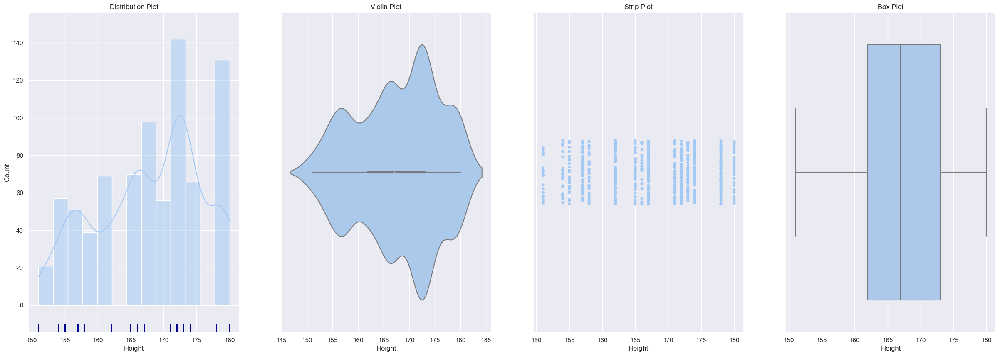

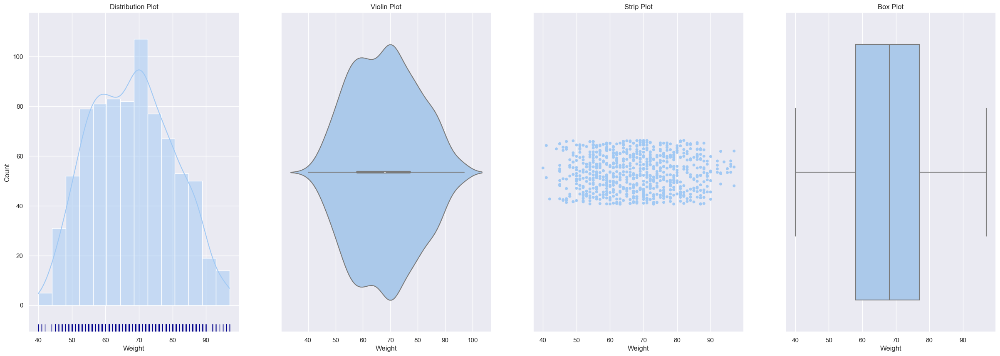

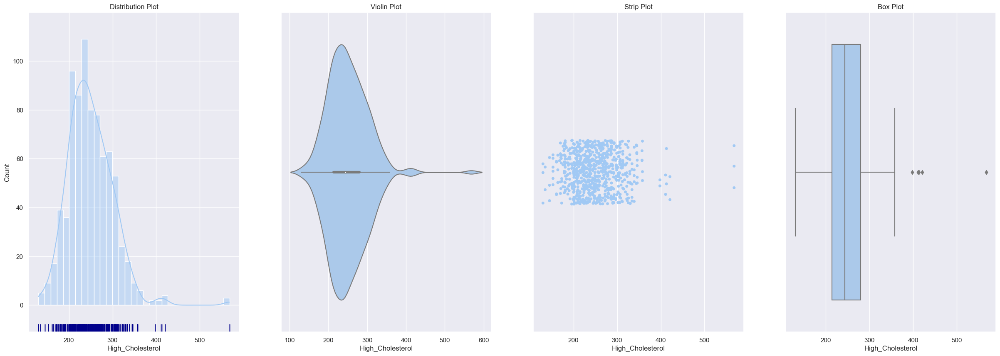

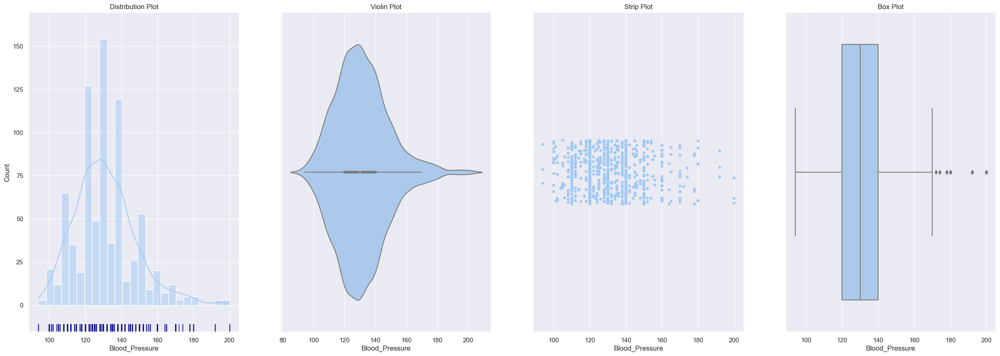

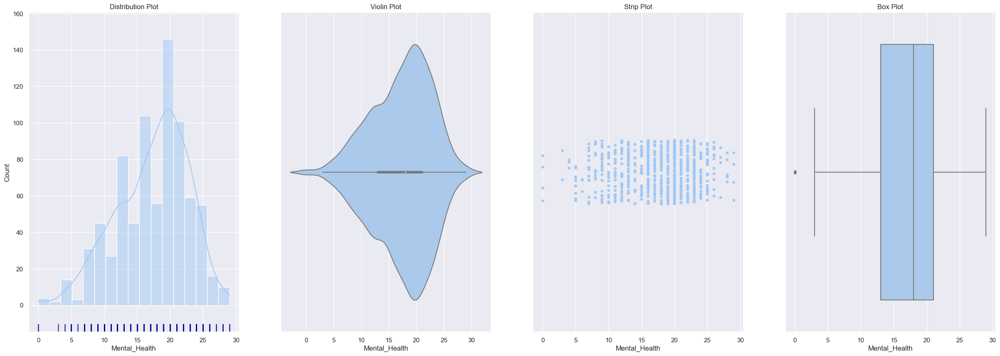

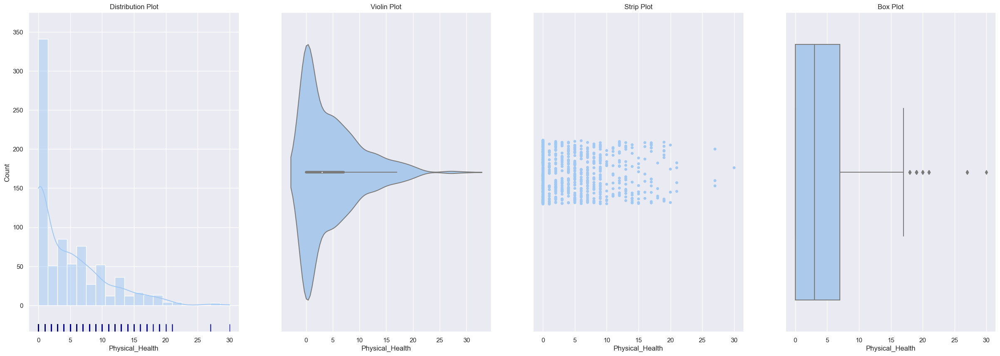

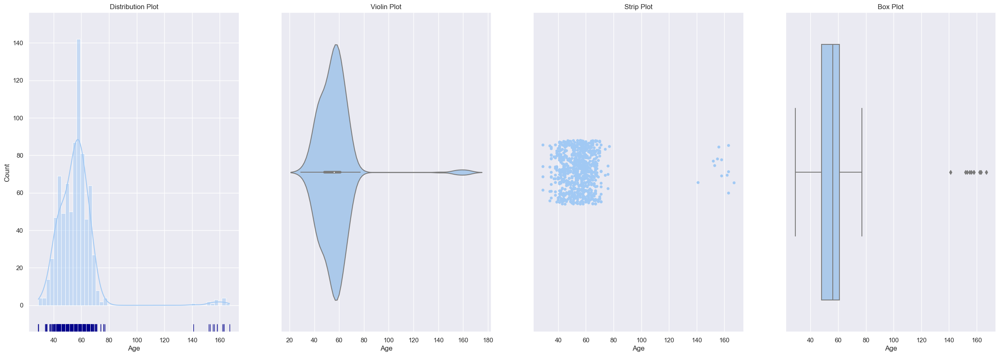

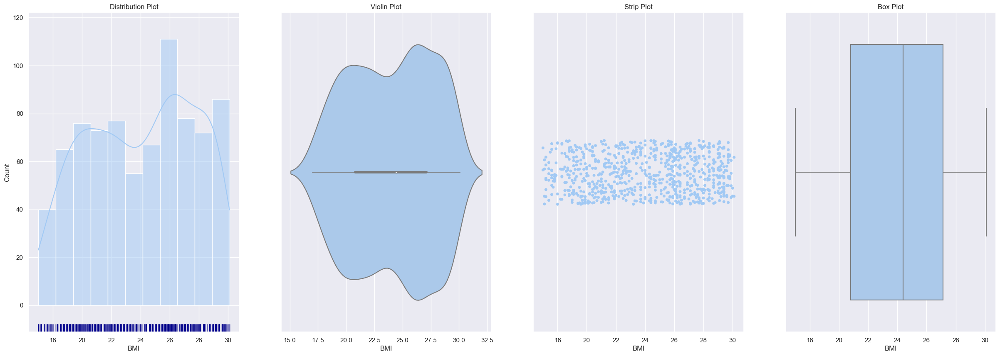

In [35]:
num_cols = df_metricfeatures.columns

for col in num_cols:
    univariate_numeric(df,col)

##### b) Categorical Data

In [36]:
def univariate_categorical(df,col): 
    
    fig, ax = plt.subplots(1,2, figsize=(10,5)) 
    
    ax[0].set_title("xxxxxxxxxxxxxxxx Plot")
    g=sns.countplot(x=df[col], ax=ax[0])
    
    #wrap text label 
    g.set_xticklabels([textwrap.fill(t.get_text(), 10)  for t in ax[0].get_xticklabels()],fontsize=8, rotation=45)

    #pie
    labels = df[col].value_counts().index
    labels = [textwrap.fill(str(label), 20)  for label in labels]
    
    ax[1]=plt.pie(df[col].value_counts().values, labels= labels,
                autopct='%0.1f%%', startangle=60,textprops={'fontsize': 8})
  
    plt.show()

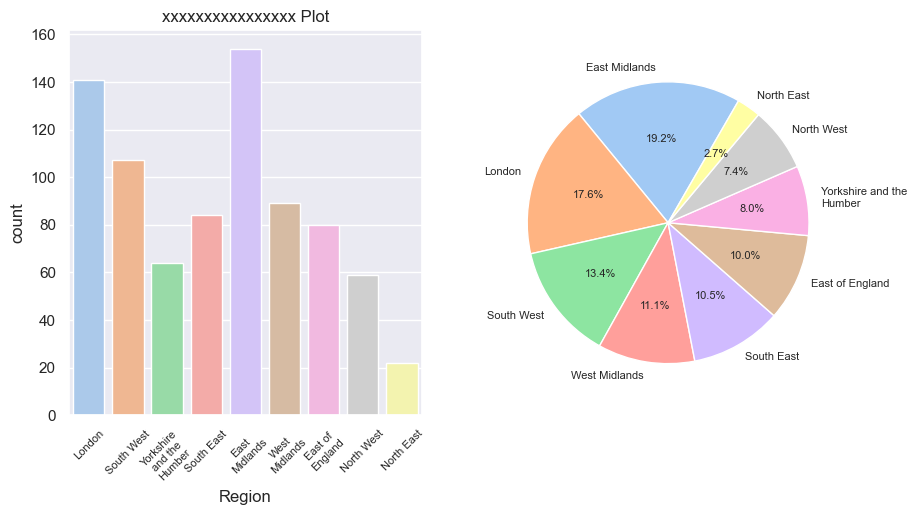

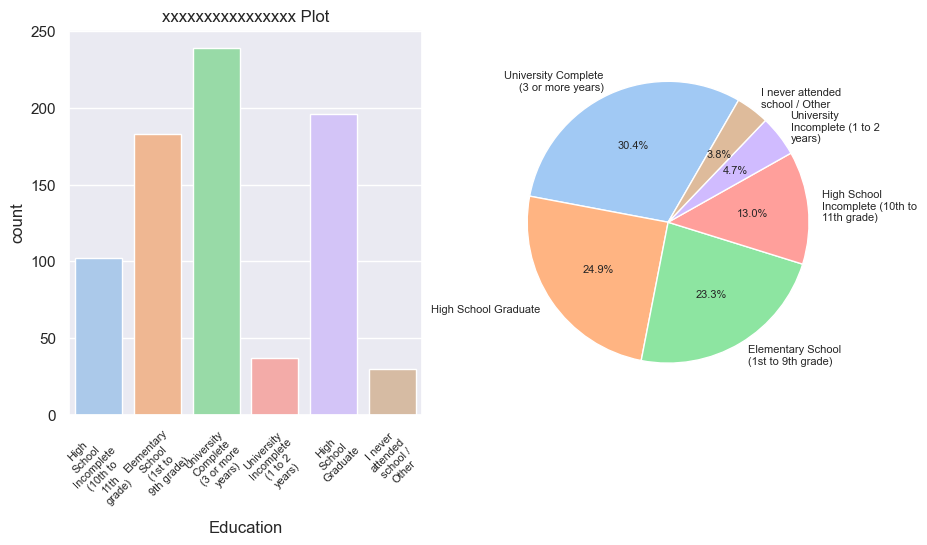

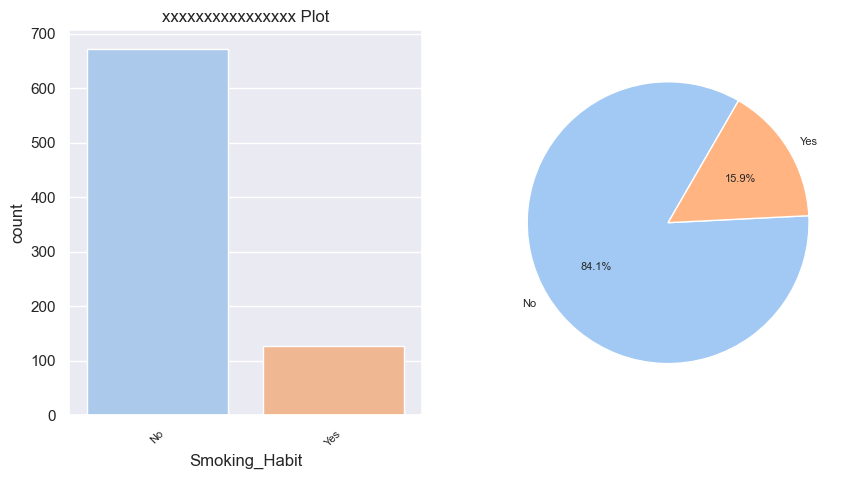

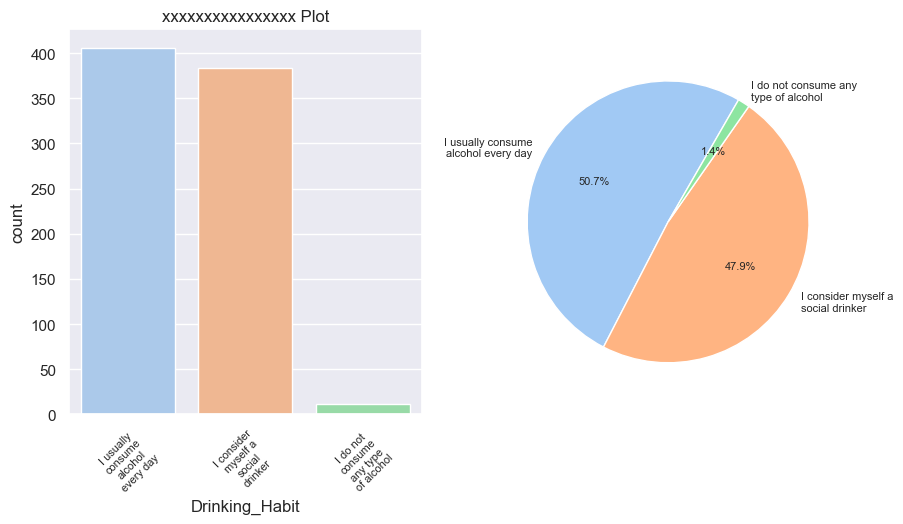

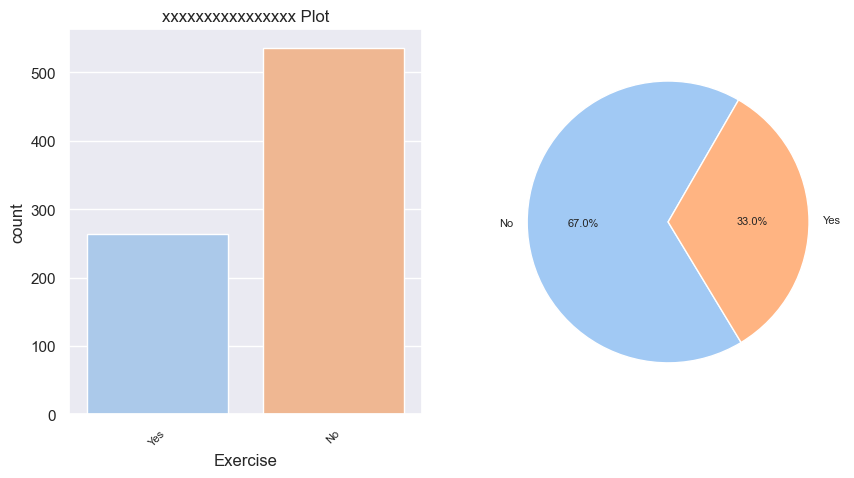

...

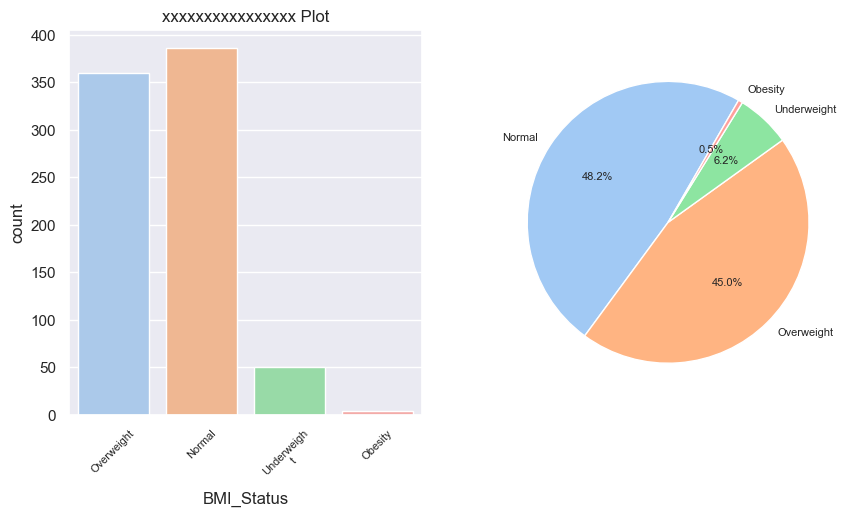

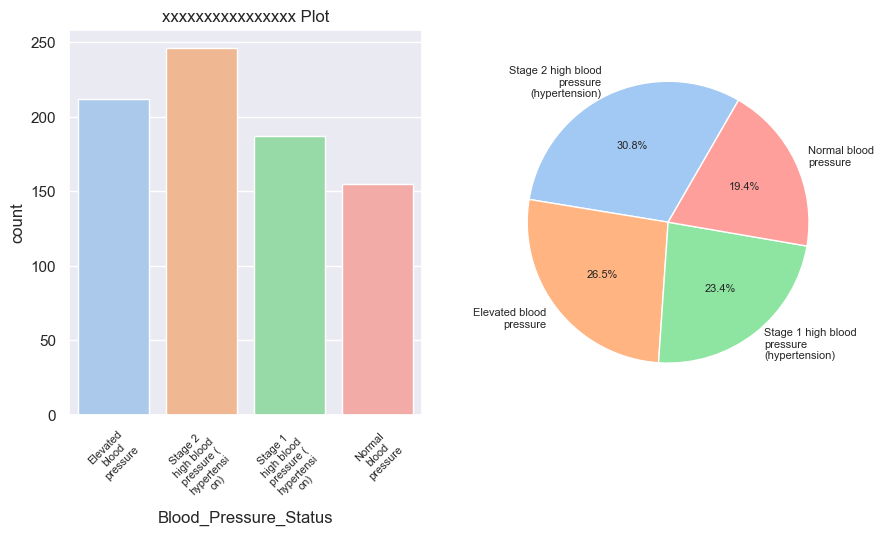

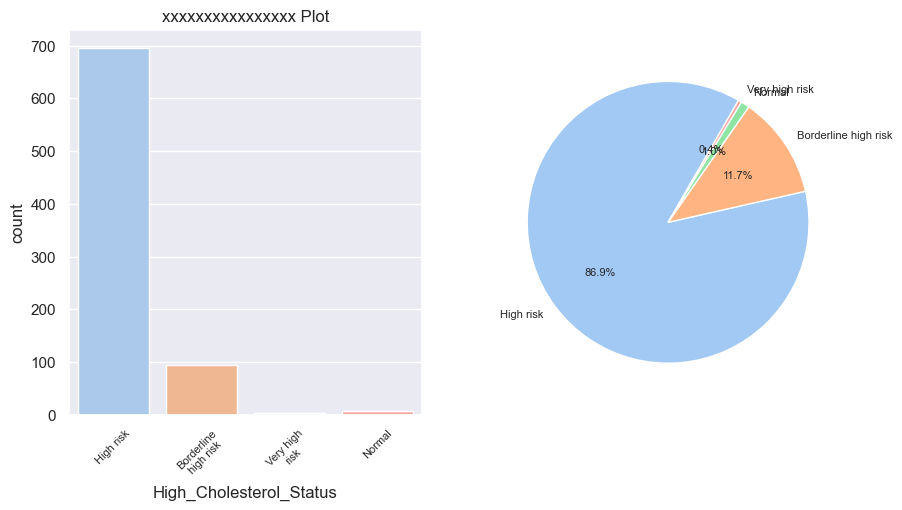

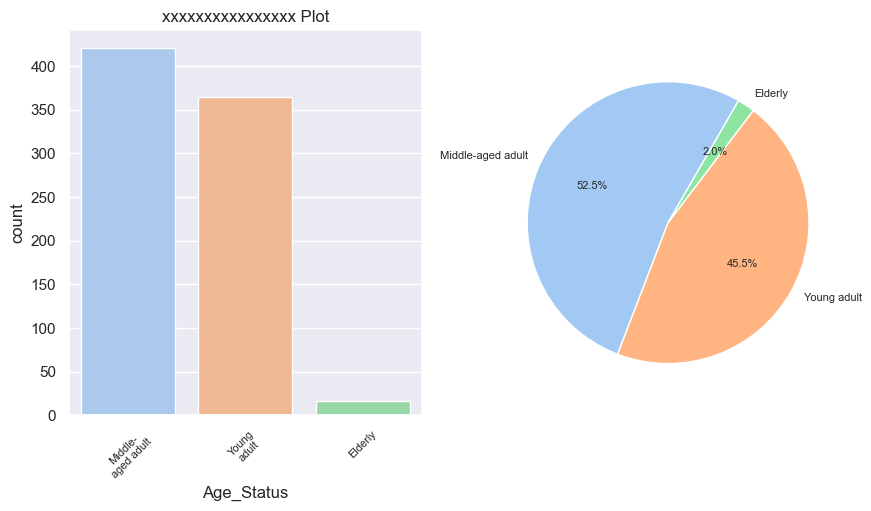

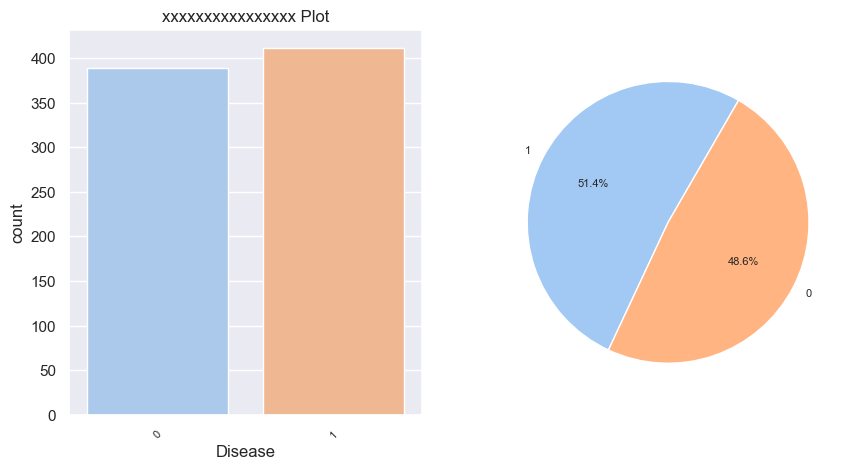

In [37]:
all_cats = pd.concat([df_nonmetricfeatures,df_target],axis=1)

cat_cols = all_cats.columns[all_cats.nunique() < 15]

for col in cat_cols:
    univariate_categorical(df,col)

#### 2.4.3. Bivariate Analysis <a class="anchor" id="section_2_4_3"></a>


##### a) Continuous vs Continuous

In [38]:
# https://stackoverflow.com/questions/35042255/how-to-plot-multiple-seaborn-jointplot-in-subplot/47664533#47664533
class SeabornFig2Grid():

    def __init__(self, seaborngrid, fig,  subplot_spec):
        self.fig = fig
        self.sg = seaborngrid
        self.subplot = subplot_spec
        if isinstance(self.sg, sns.axisgrid.FacetGrid) or \
            isinstance(self.sg, sns.axisgrid.PairGrid):
            self._movegrid()
        elif isinstance(self.sg, sns.axisgrid.JointGrid):
            self._movejointgrid()
        self._finalize()

    def _movegrid(self):
        """ Move PairGrid or Facetgrid """
        self._resize()
        n = self.sg.axes.shape[0]
        m = self.sg.axes.shape[1]
        self.subgrid = gridspec.GridSpecFromSubplotSpec(n,m, subplot_spec=self.subplot)
        for i in range(n):
            for j in range(m):
                self._moveaxes(self.sg.axes[i,j], self.subgrid[i,j])

    def _movejointgrid(self):
        """ Move Jointgrid """
        h= self.sg.ax_joint.get_position().height
        h2= self.sg.ax_marg_x.get_position().height
        r = int(np.round(h/h2))
        self._resize()
        self.subgrid = gridspec.GridSpecFromSubplotSpec(r+1,r+1, subplot_spec=self.subplot)

        self._moveaxes(self.sg.ax_joint, self.subgrid[1:, :-1])
        self._moveaxes(self.sg.ax_marg_x, self.subgrid[0, :-1])
        self._moveaxes(self.sg.ax_marg_y, self.subgrid[1:, -1])

    def _moveaxes(self, ax, gs):
        #https://stackoverflow.com/a/46906599/4124317
        ax.remove()
        ax.figure=self.fig
        self.fig.axes.append(ax)
        self.fig.add_axes(ax)
        ax._subplotspec = gs
        ax.set_position(gs.get_position(self.fig))
        ax.set_subplotspec(gs)

    def _finalize(self):
        plt.close(self.sg.fig)
        self.fig.canvas.mpl_connect("resize_event", self._resize)
        self.fig.canvas.draw()

    def _resize(self, evt=None):
        self.sg.fig.set_size_inches(self.fig.get_size_inches())

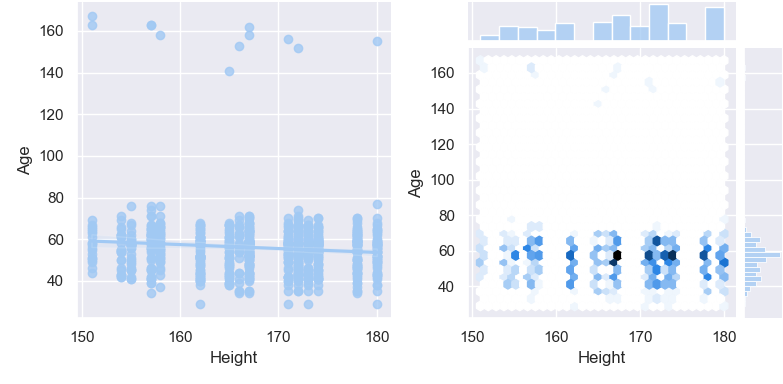

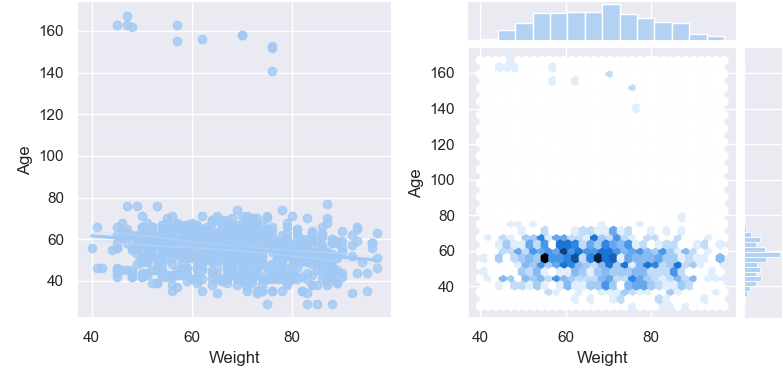

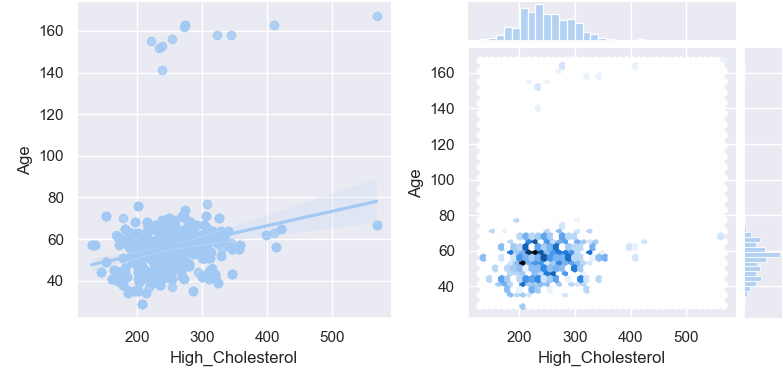

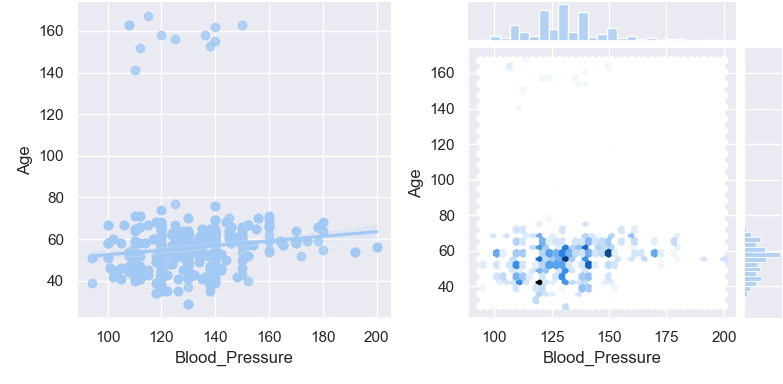

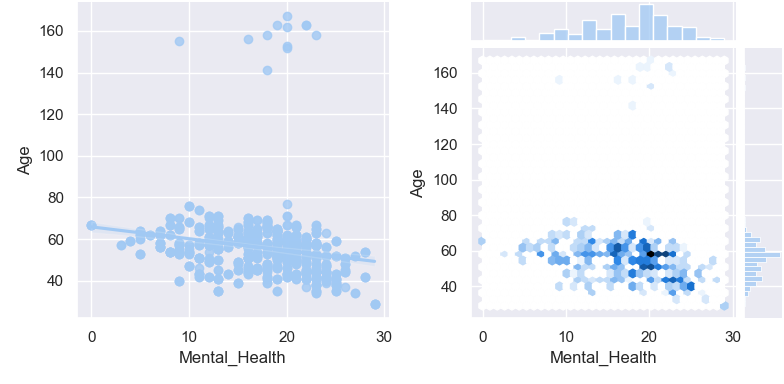

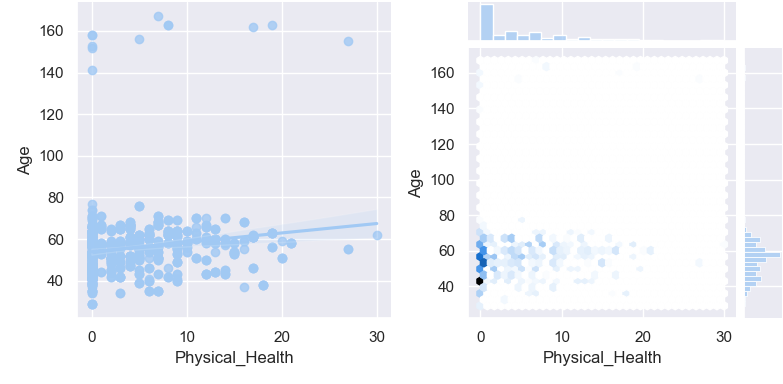

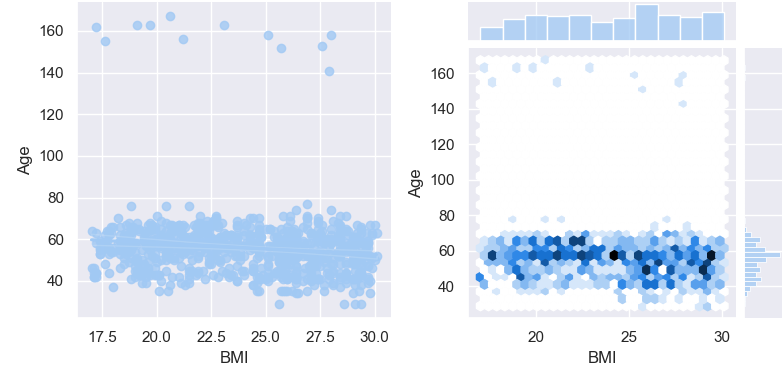

In [39]:
# Age
def bivariate_cntvscnt(df,cnt1,cnt2):
    #sns.jointplot(x=cnt1, y=cnt2, data=df, kind='hex', gridsize=20)
    
    for cnt in cnt2:

        g0 = sns.lmplot(data= df, x=cnt, y= cnt1) 
        g1 = sns.jointplot(data= df, x=cnt, y= cnt1, kind='hex') 
        fig = plt.figure(figsize=(8,4))
        gs = gridspec.GridSpec(1, 2)

        mg0 = SeabornFig2Grid(g0, fig, gs[0])
        mg1 = SeabornFig2Grid(g1, fig, gs[1])

        gs.tight_layout(fig)

        plt.show()


continuous = df_metricfeatures.drop('Age', axis=1)
bivariate_cntvscnt(df,'Age',continuous)

##### b) Categorical vs Categorical

In [40]:
def bivariate_catvstgt(df,col,target): 
    
    fig, ax=plt.subplots(nrows =1,ncols=3,figsize=(20,8))
       
    #Aggregation function #1
    df_plot = df.groupby([col, target]).size().reset_index().pivot(columns=target, index=col, values=0)
    
    ax[0].set_title("xxxxxxxxxxxx Plot")
    g=df_plot.plot(kind='bar', stacked=True,ax=ax[0])
    
    #wrap text label 
    g.set_xticklabels([textwrap.fill(t.get_text(), 10)  for t in ax[0].get_xticklabels()], rotation=0)
    

    #Aggregation function #2
    df_plot = pd.crosstab(df[col], df.iloc[: , -1], normalize='index')
    

    ax[1].set_title("xxxxxxxxxxxx Plot")
    g = df_plot.plot(kind='bar', stacked=True, ax=ax[1])

    #wrap text label 
    g.set_xticklabels([textwrap.fill(t.get_text(), 10)  for t in ax[1].get_xticklabels()], rotation=0)
    
    
  
    #Aggregation function #3
    df_plot = pd.crosstab(df.iloc[: , -1], df[col], normalize='index')

    ax[2].set_title("xxxxxxxxxxxx Plot")
    g = df_plot.plot(kind='bar', stacked=True, ax=ax[2])

    #wrap text label 
    g.set_xticklabels([textwrap.fill(t.get_text(), 10)  for t in ax[2].get_xticklabels()], rotation=0)
    
    
    plt.show()

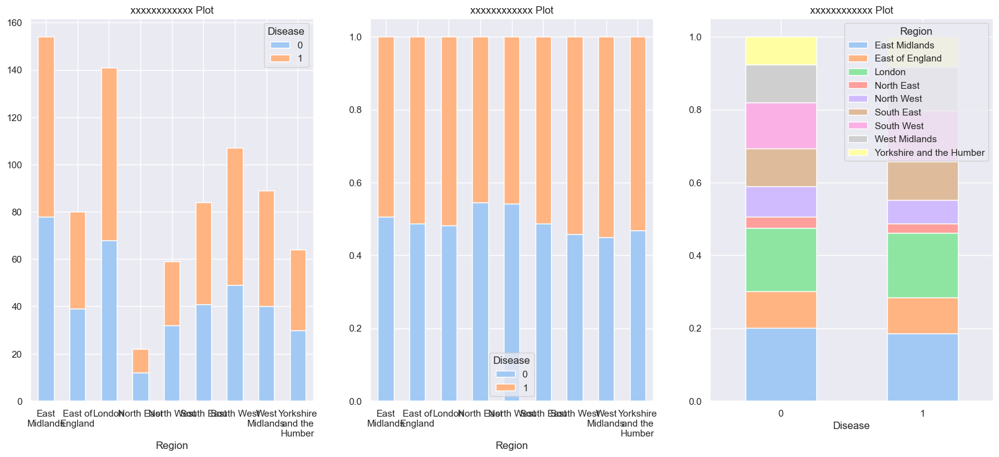

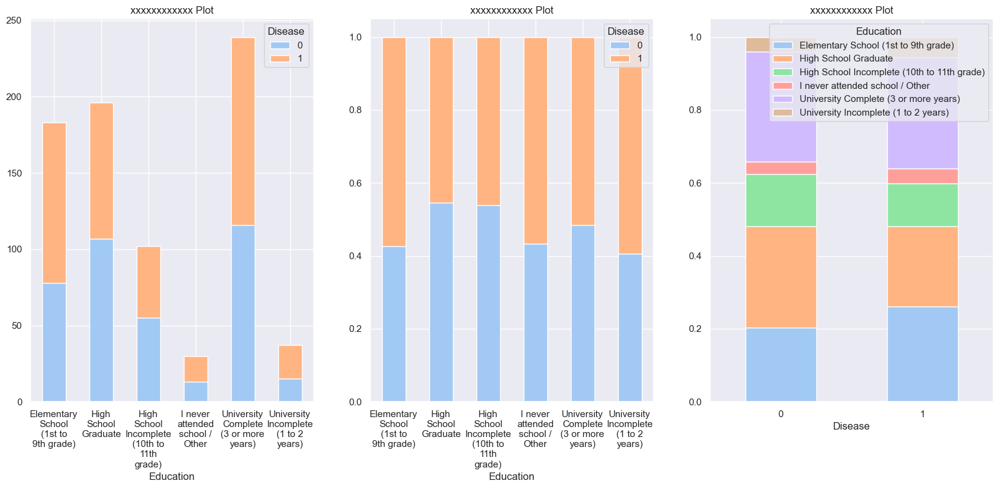

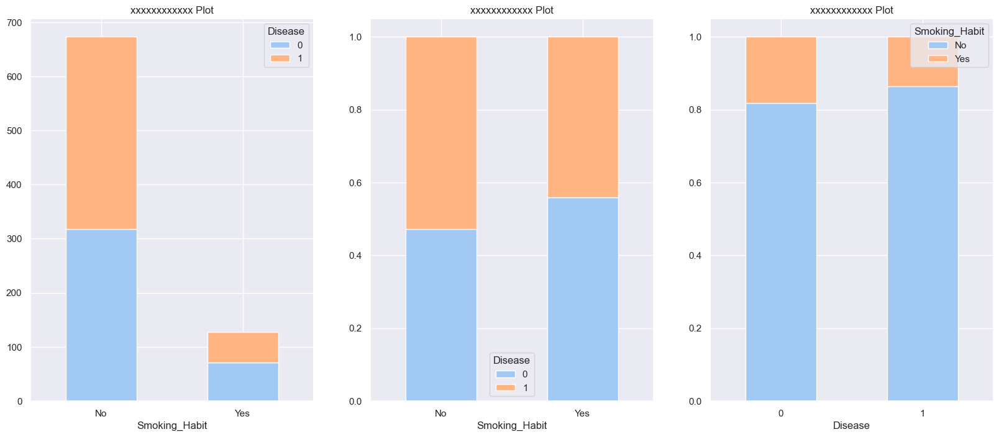

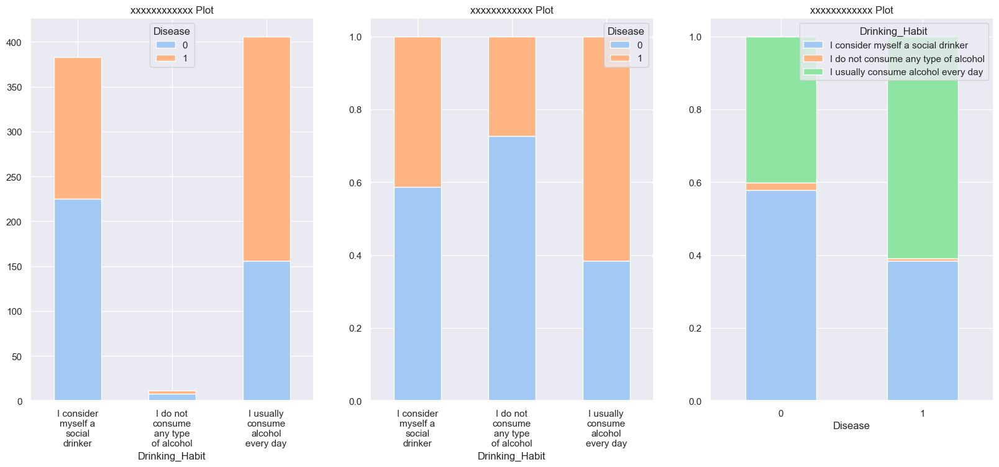

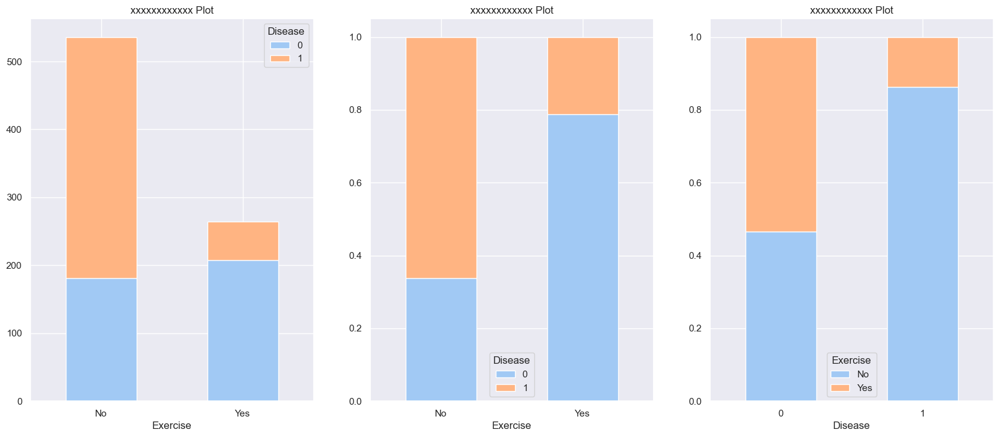

...

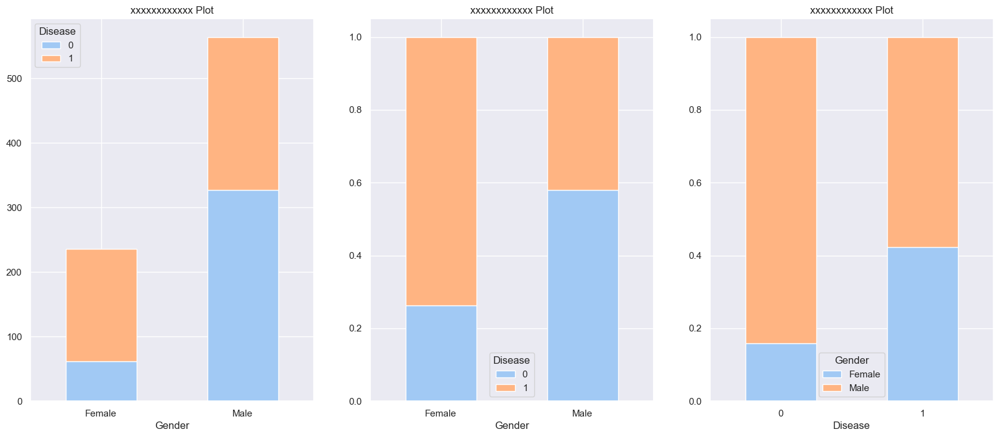

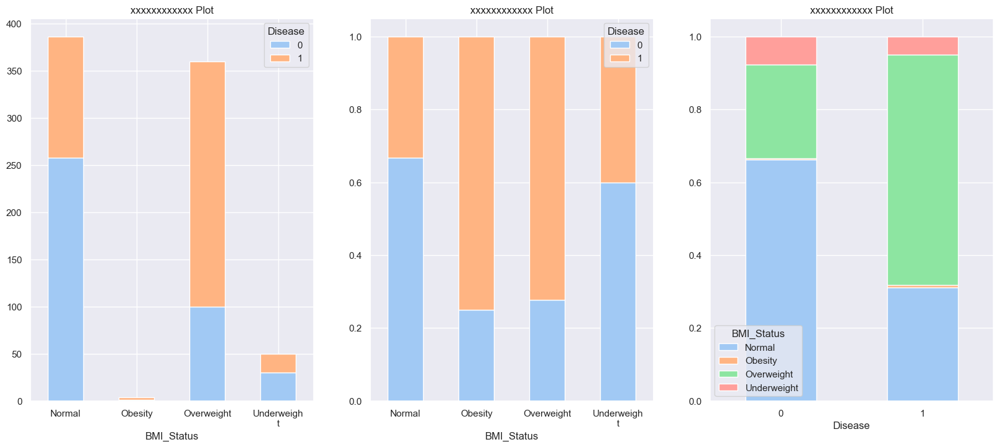

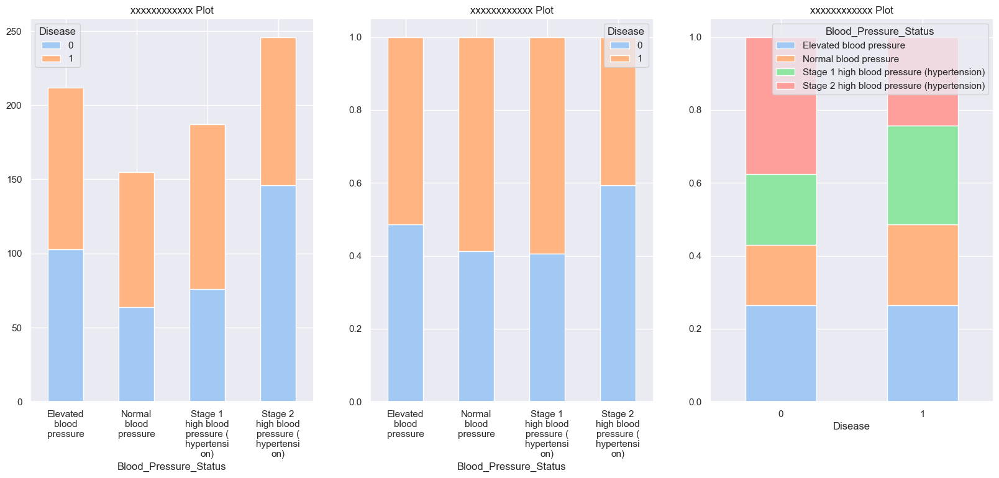

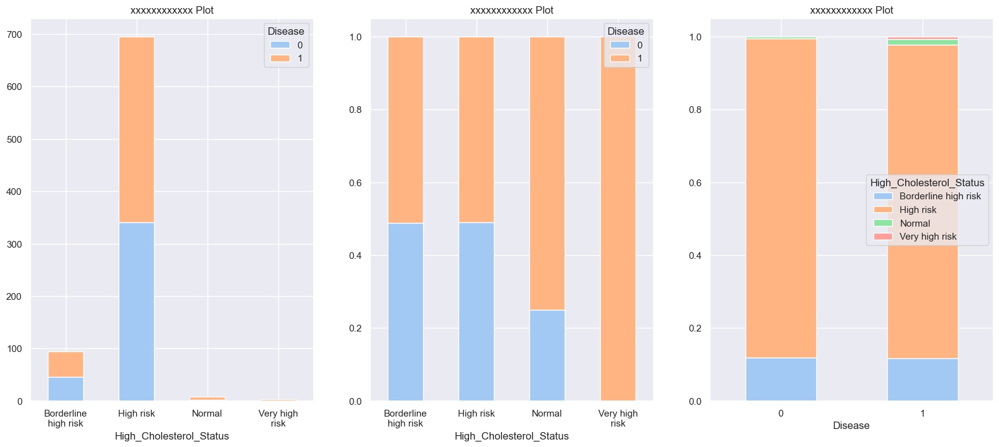

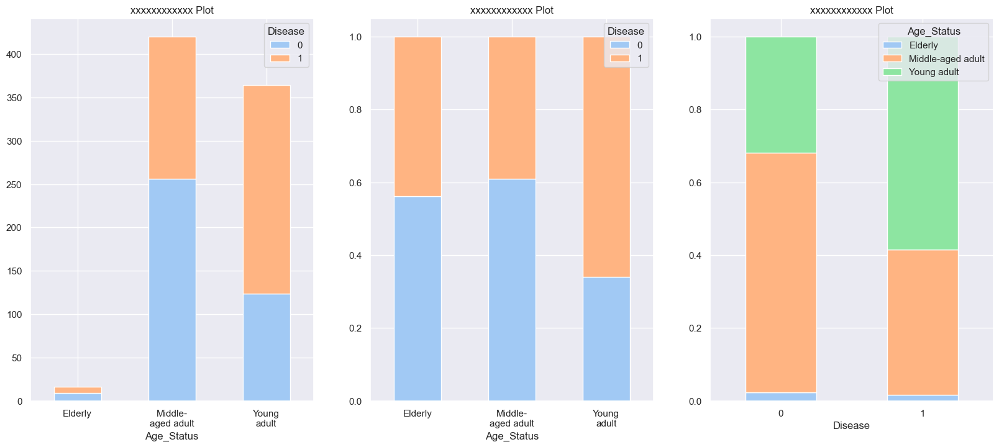

In [41]:
all_cats = df_nonmetricfeatures

cat_cols = all_cats.columns[all_cats.nunique() < 15]

for col in cat_cols:
    bivariate_catvstgt(df,col,name_target)

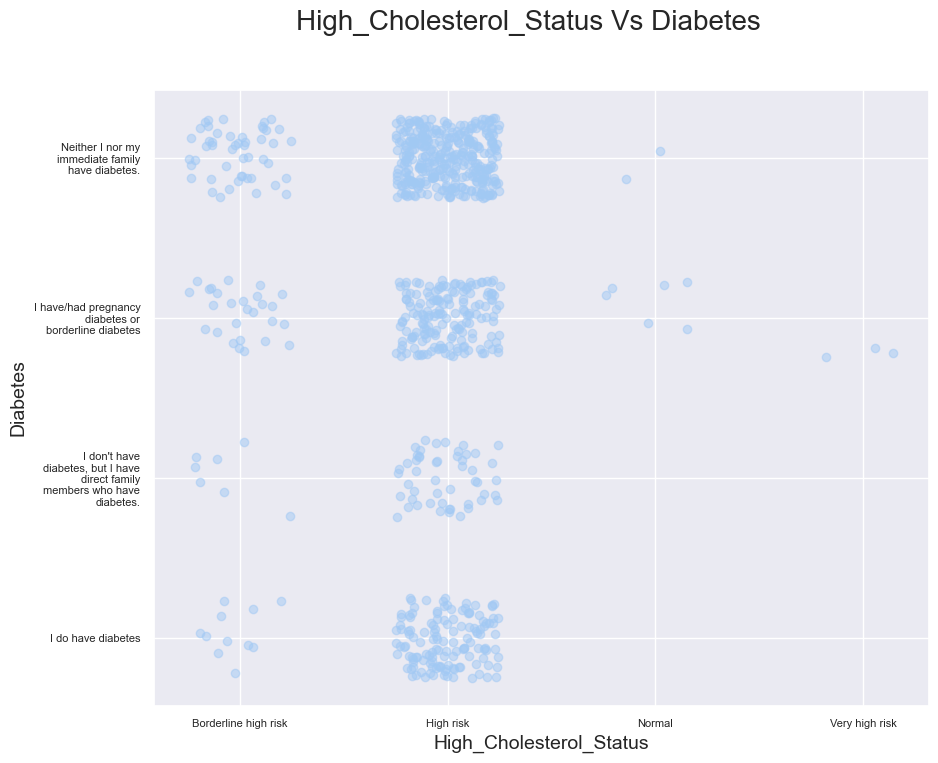

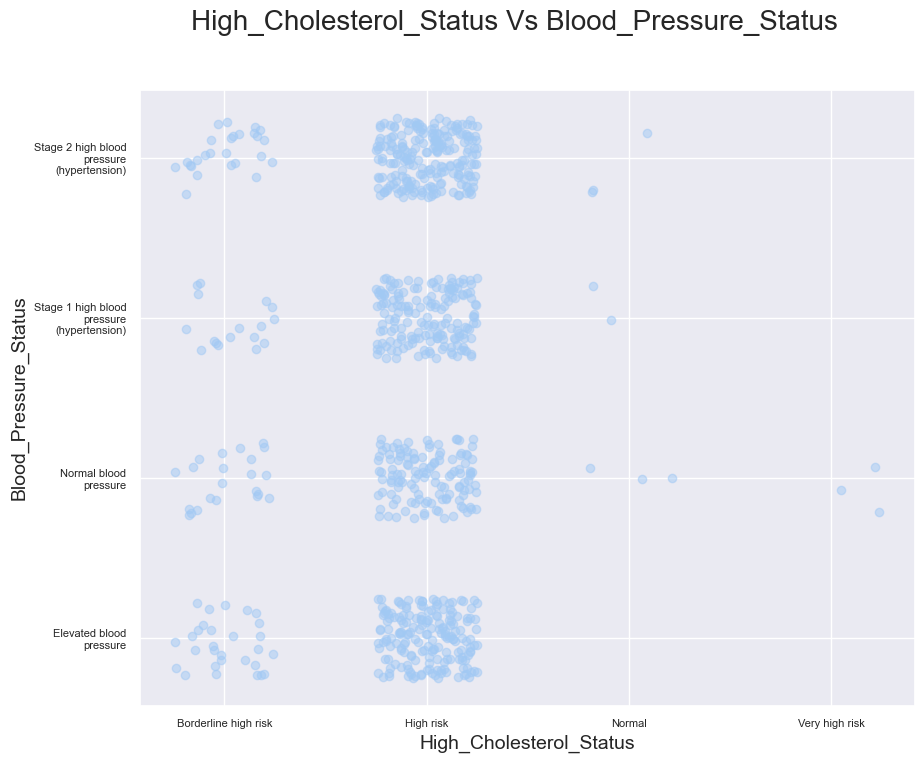

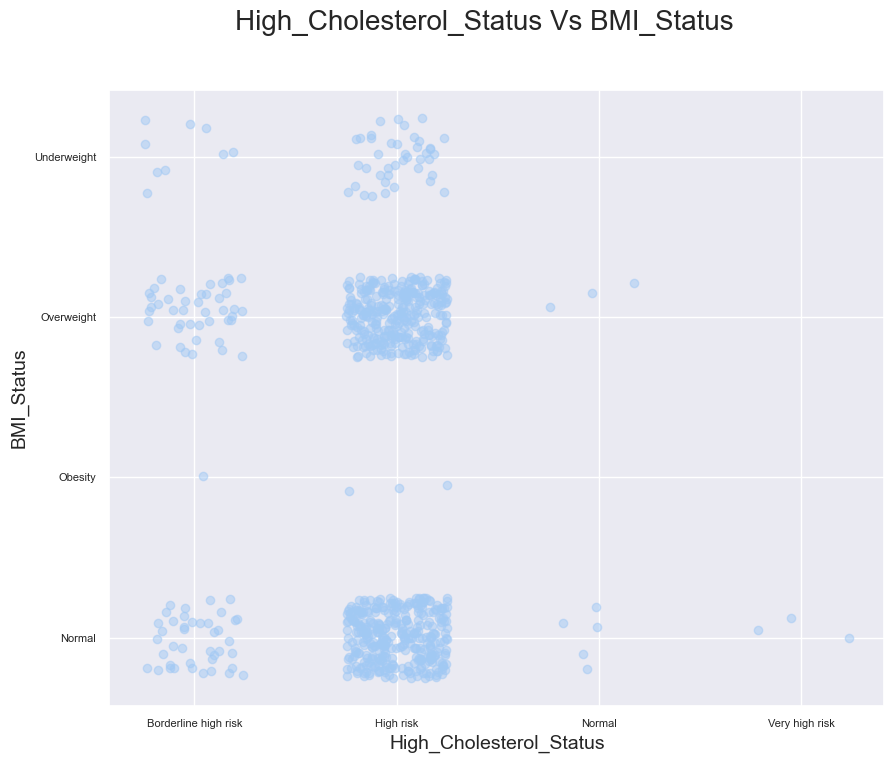

In [42]:
#Adapted: https://datascience.stackexchange.com/questions/89692/plot-two-categorical-variables

# Categorical - Diabetes Vs Cholesterol
def univariate_catvscat (df,cat1, cat2):

    fig = plt.figure(figsize=(10,8))
    # This is to encode the data into numbers that can be used in our scatterplot
    
    ord_enc = OrdinalEncoder()
    encoder = OrdinalEncoder()
    # transform data
    enc_df = pd.DataFrame(ord_enc.fit_transform(df[[cat1,cat2]]), columns=[cat1,cat2])
    categories = pd.DataFrame(np.array(ord_enc.categories_).transpose(), columns=[cat1,cat2])

    # Generate the random noise
    xnoise, ynoise = np.random.random(len(df[[cat1,cat2]]))/2, np.random.random(len(df[[cat1,cat2]]))/2 # The noise is in the range 0 to 0.5

    # Plot the scatterplot
    plt.suptitle(cat1 + ' Vs ' + cat2, fontsize=20)
    plt.scatter(enc_df[cat1]+xnoise, enc_df[cat2]+ynoise, alpha=0.5)
    
    # You can also set xticks and yticks to be your category names:
    labels_cat1 = categories[cat1].value_counts().index
    labels_cat1 = [textwrap.fill(str(label), 20)  for label in labels_cat1]
    plt.xticks([0.25, 1.25, 2.25, 3.25], labels_cat1, fontsize=8,) # The reason the xticks start at 0.25
    plt.xlabel(cat1, fontsize=14)
    # and go up in increments of 1 is because the center of the noise will be around 0.25 and ordinal
    # encoded labels go up in increments of 1.
    labels_cat2 = categories[cat2].value_counts().index
    labels_cat2 = [textwrap.fill(str(label), 20)  for label in labels_cat2]
    plt.yticks([0.25, 1.25, 2.25, 3.25], labels_cat2, fontsize=8) # This has the same reason explained for xticks
    
    plt.ylabel(cat2, fontsize=14)
    plt.grid(True)

univariate_catvscat (df, 'High_Cholesterol_Status','Diabetes')
univariate_catvscat (df, 'High_Cholesterol_Status','Blood_Pressure_Status')
univariate_catvscat (df,'High_Cholesterol_Status','BMI_Status')

##### c) Continuous vs Categorical

In [43]:

def bivariate_contvscat(df,col, target):    

    sns.set(style="darkgrid")
    fig, ax=plt.subplots(nrows =1,ncols=4,figsize=(20,8))
    
    ax[0].set_title("Density Plot")
    
    ax[1].set_title("Violin Plot")
    sns.violinplot(x=col, y=target, data=df, ax = ax[1], orient='h', hue=target)
    ax[2].set_title("Strip Plot")
    
    ax[3].set_title("Box Plot")
    sns.boxplot(y=col, x=target, data=df, ax = ax[3], orient='v', hue=target)

    
    target_types = set(df[target])
    for i,tg in enumerate(target_types):
        sns.kdeplot(x = df[df[target] == tg][col] ,ax = ax[0] , fill=True,)
        sns.stripplot(data=df[df[target] == tg], x=col, ax=ax[2],orient='h', hue=target, color=sns.color_palette()[i])
        
    
    # Compose a custom legend
    custom_lines = [
        Line2D([0], [0], color=sns.color_palette()[i], lw=4, alpha=0.25) 
        for i, tg in enumerate(target_types)
    ]
    ax[0].legend(
        custom_lines, 
        [f"{tg}" for tg in target_types], 
        title=target
    )
    
    plt.show()

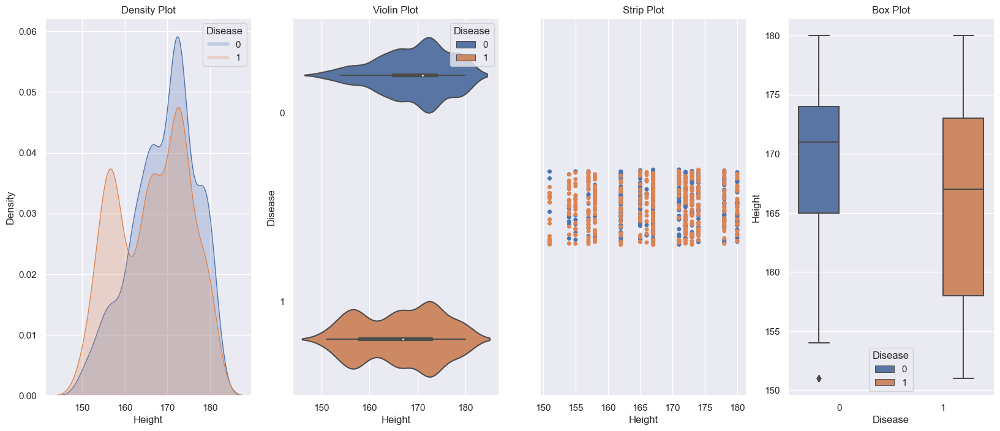

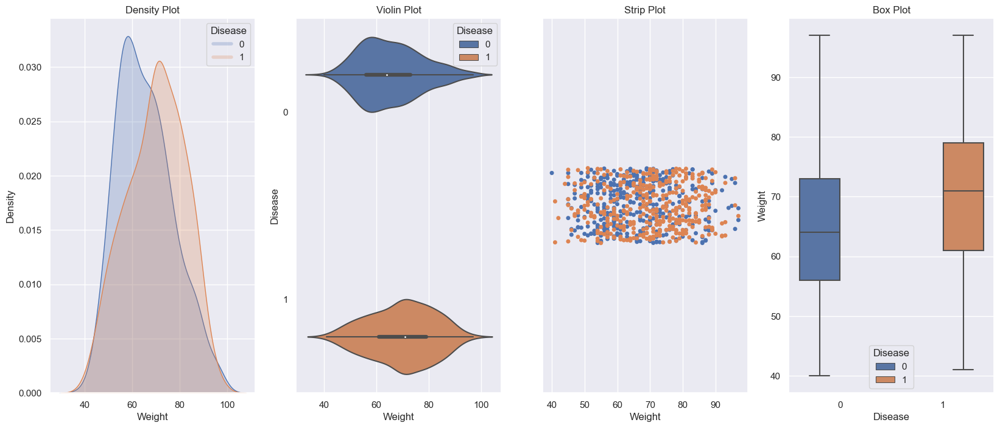

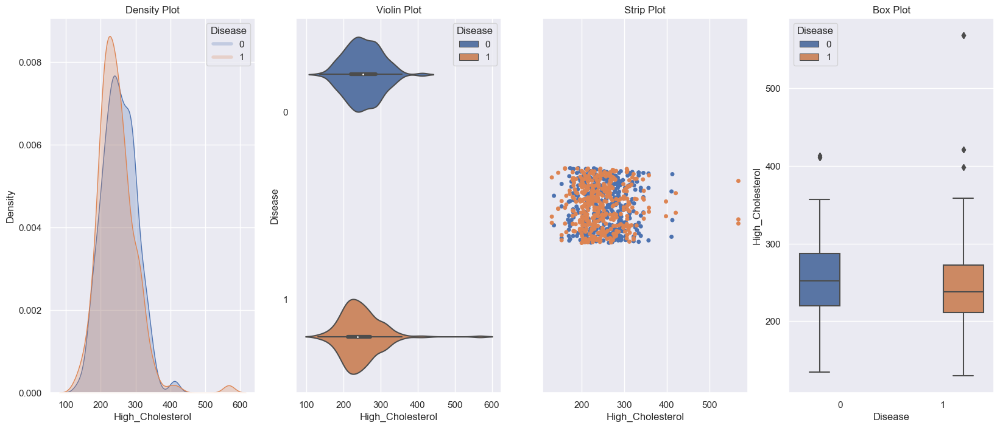

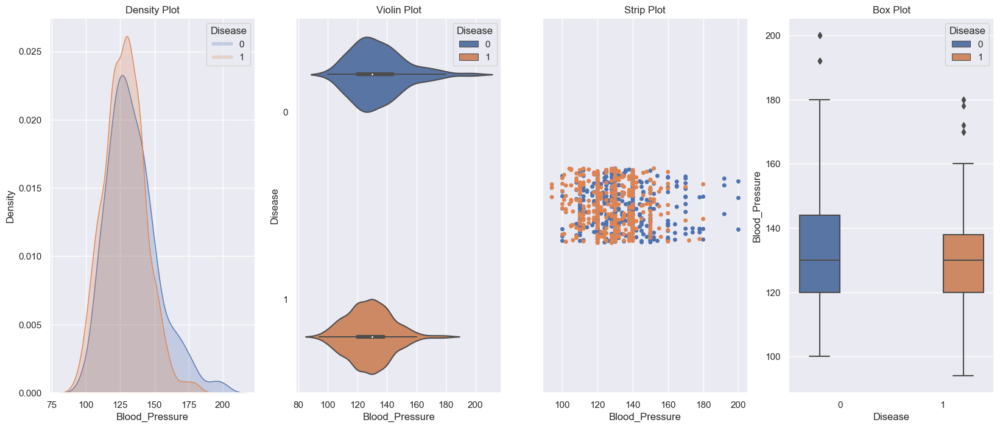

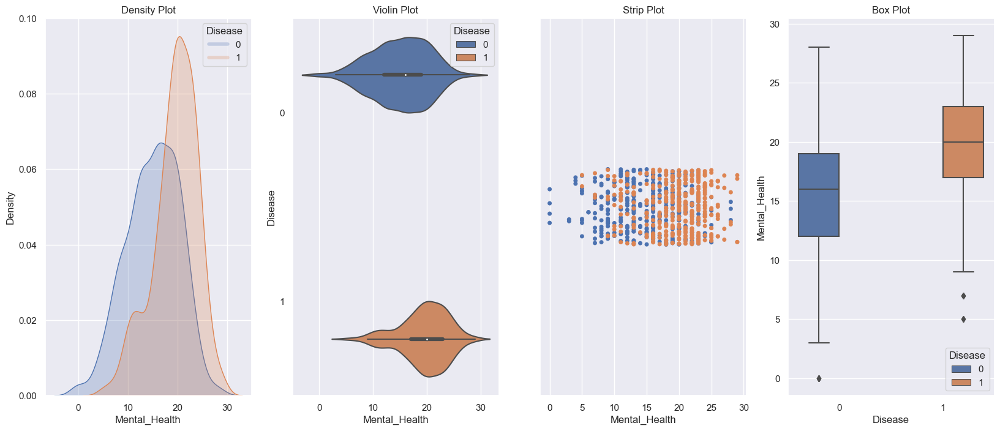

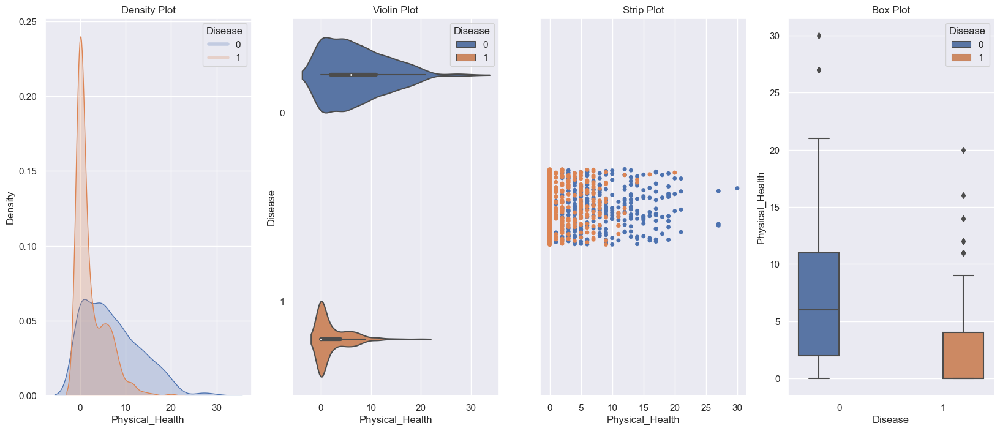

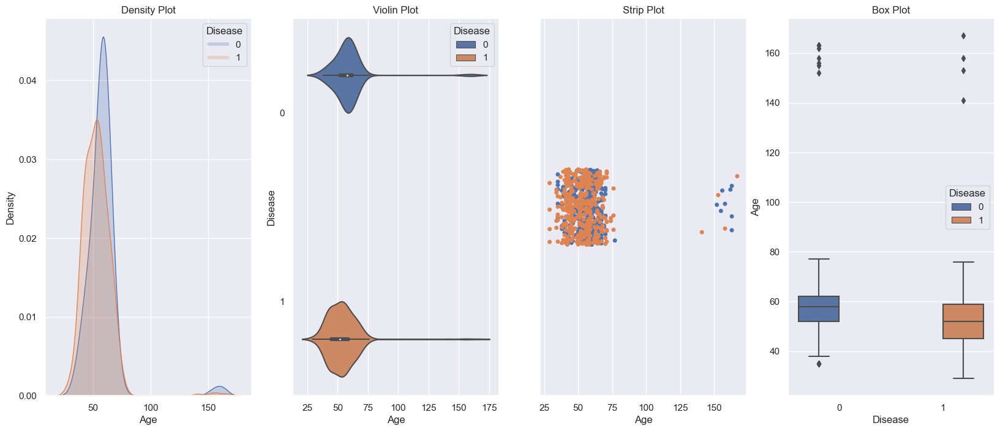

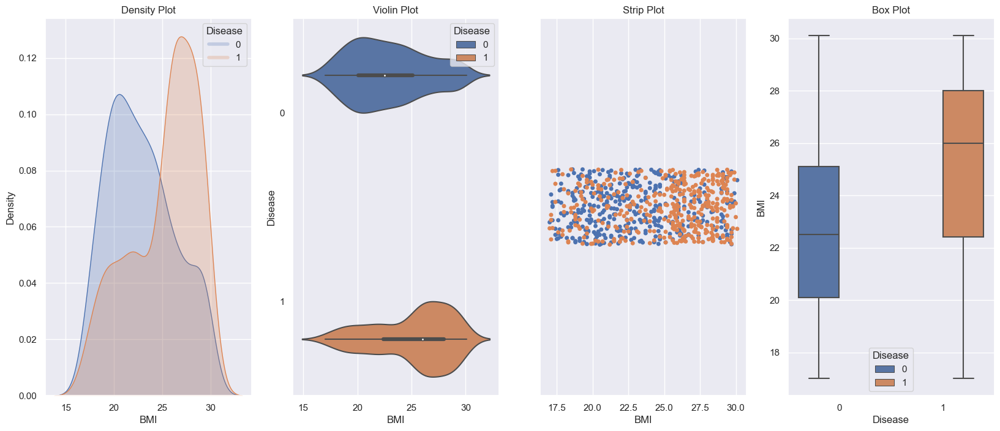

In [44]:

num_cols = df_metricfeatures.columns


for col in num_cols:
    bivariate_contvscat(df,col,name_target)

#### 2.4.4 Multivariate Analysis <a class="anchor" id="section_2_4_4"></a>

##### a) Continuous vs Continuous

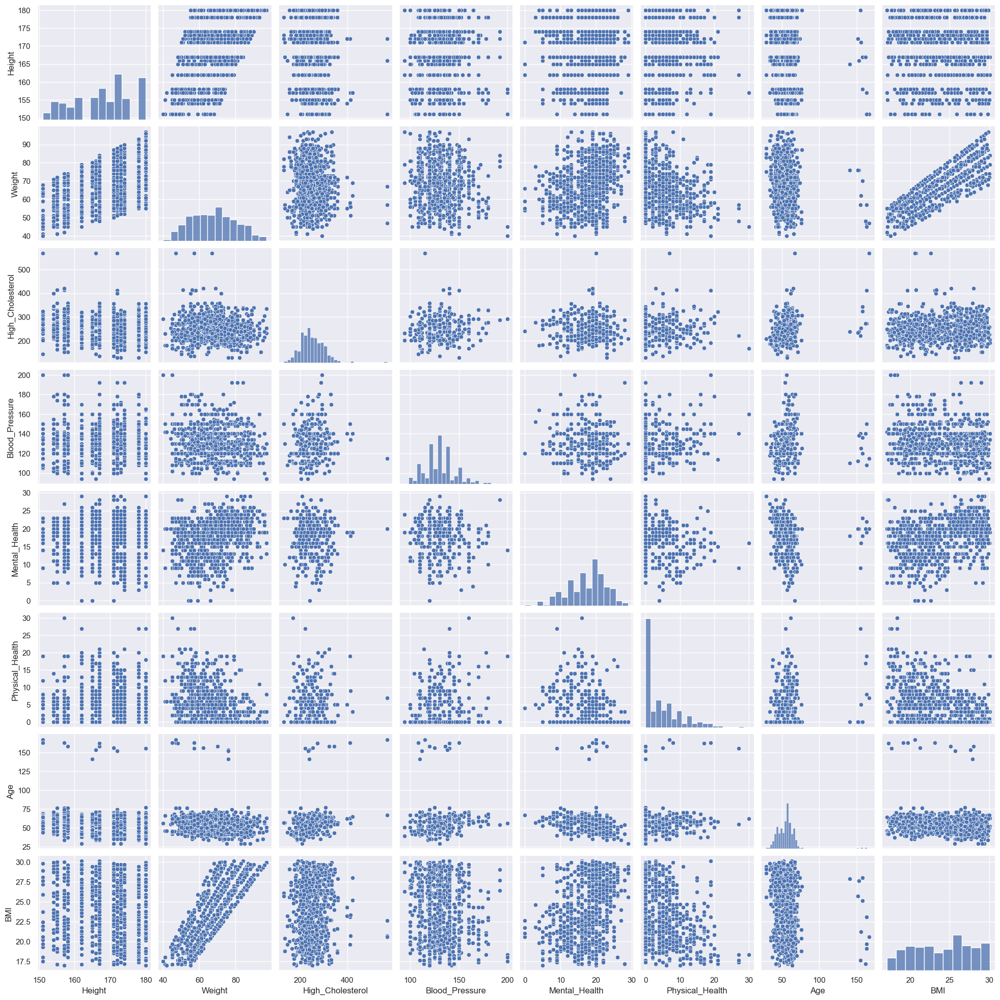

In [45]:
sns.pairplot(data = df, vars=df_metricfeatures)
plt.show()

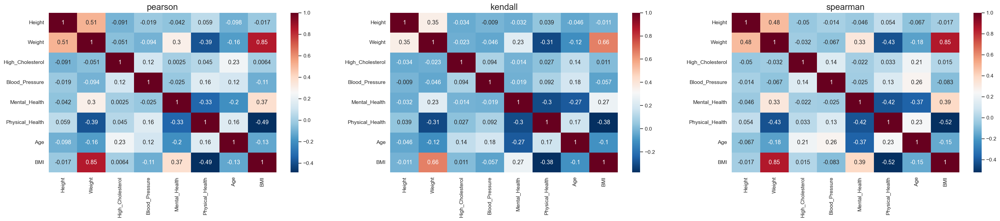

In [46]:
# plotting heatmap using all methods for all numerical variables (peason, kendall, spearman)
plt.figure(figsize=(36,6), dpi=140)
for j,i in enumerate(['pearson','kendall','spearman']):
    plt.subplot(1,3,j+1)
    corrs = df_metricfeatures.corr(method=i)
    sns.heatmap(corrs, cmap='RdBu_r',annot=True)
    plt.title(i, fontsize=18)
plt.show()

##### b) Categorical vs Categorical

In [47]:
df1 = df.groupby(['Surname','Region']).size().sort_values(ascending=False).reset_index(name='Count')
print(df1[df1['Count']>1])

df2 = df.groupby(['Surname','Region','Disease']).size().sort_values(ascending=False).reset_index(name='Count')
df2[(df2['Count']>1)]

      Surname           Region  Count
0       Jones           London      3
1    Williams           London      3
2     Johnson           London      3
3        Hall           London      3
4       Green    East Midlands      2
5        Ross    West Midlands      2
6     Mahoney       North West      2
7       Davis       South East      2
8      Garcia       South West      2
9      Morris    East Midlands      2
10    Johnson  East of England      2
11      Giles           London      2
12      Brown       South West      2
13       King           London      2
14   Thompson           London      2
15     Thomas    West Midlands      2
16      Smith    West Midlands      2
17     Miller    West Midlands      2
18     Harris    West Midlands      2
19     Taylor    East Midlands      2
20   Campbell    East Midlands      2
21      Emery       South East      2
22   Campbell       South East      2
23  Rodriguez  East of England      2
24   Campbell       North West      2
25   William

,Surname,Region,Disease,Count
0,Johnson,London,0,2
1,Garcia,South West,1,2
2,Williams,London,1,2
3,King,London,1,2
4,Johnson,East of England,1,2
5,Miller,West Midlands,0,2
6,Thomas,West Midlands,1,2
7,Smith,West Midlands,1,2
8,Harris,West Midlands,1,2
9,Giles,London,1,2


In [48]:
## dataframe creation - for plotting
df_combinations = (
    df.groupby(["Disease", "Gender", "Age_Status","Exercise","BMI_Status"])
    .size()
    .reset_index()
    .rename(columns={0: "count"})
)
## Creating sunburst chart
# define figure element
fig = px.sunburst(
    df,
    path=["Disease", "Gender", "Age_Status","Exercise","BMI_Status"],
    title="Disease - Gender, Age, Exercise & BMI_Status",
    height=600,
)
# display the figure
fig.show()

##### c) Categorical vs Continuous

In [49]:
def multivariate_contvscat(df,df_col, target):
    sns.pairplot(data = df, vars=df_col,hue=target)
    plt.show()

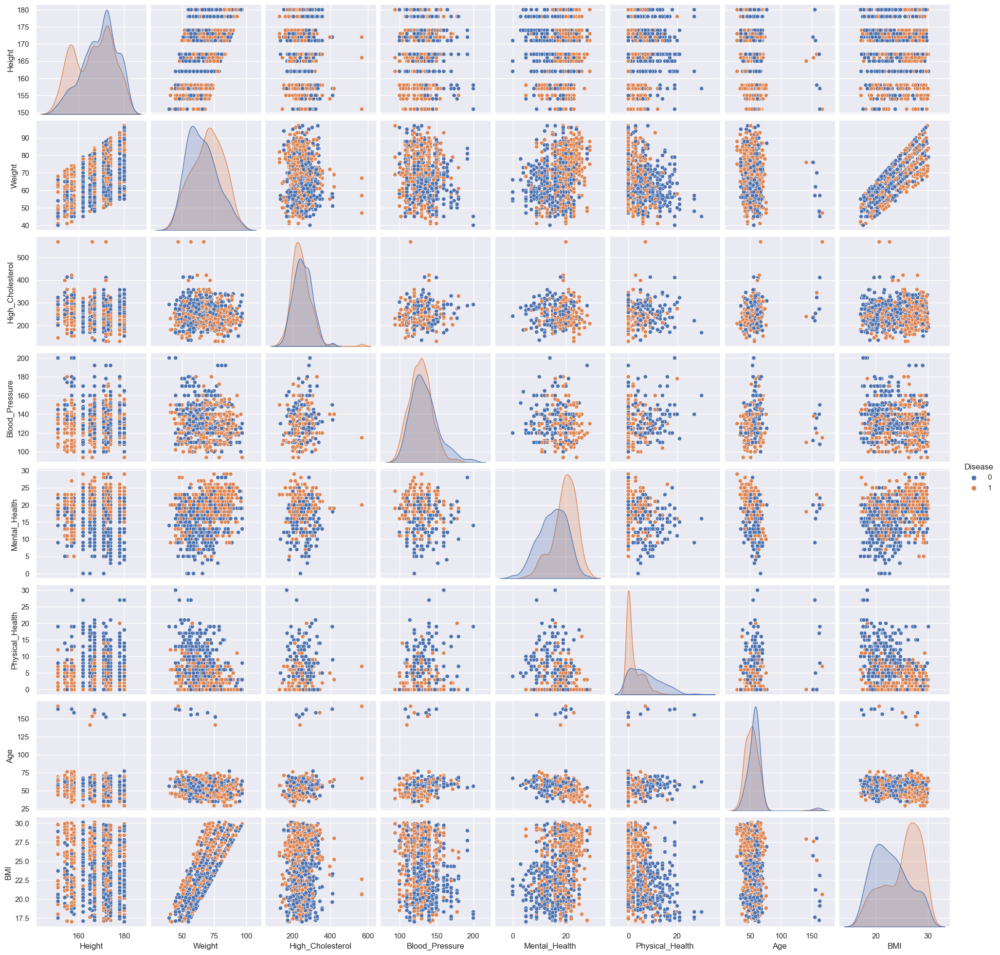

In [50]:
multivariate_contvscat (df,df_metricfeatures,name_target)

In [51]:
def multivariate_contvscat2(df, xcol, ycol, zcol, health_status):

    
    for status in health_status:
        groups = df.groupby(status)
        fig = plt.figure(figsize=(10,8))
        ax = fig.add_subplot(111, projection='3d')

        for name, group in groups:
            ax.scatter(group[xcol], group[ycol], group[zcol], label=name)
        ax.set_xlabel(xcol)
        ax.set_ylabel(ycol)
        ax.set_zlabel('Disease : 1(Yes)  0(No)')
        ax.set_title('3d plot ' + status)

        box = ax.get_position()
        ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])
        ax.legend(loc='center left', bbox_to_anchor=(1.25, 0.5), prop={'size': 10})
        plt.show()

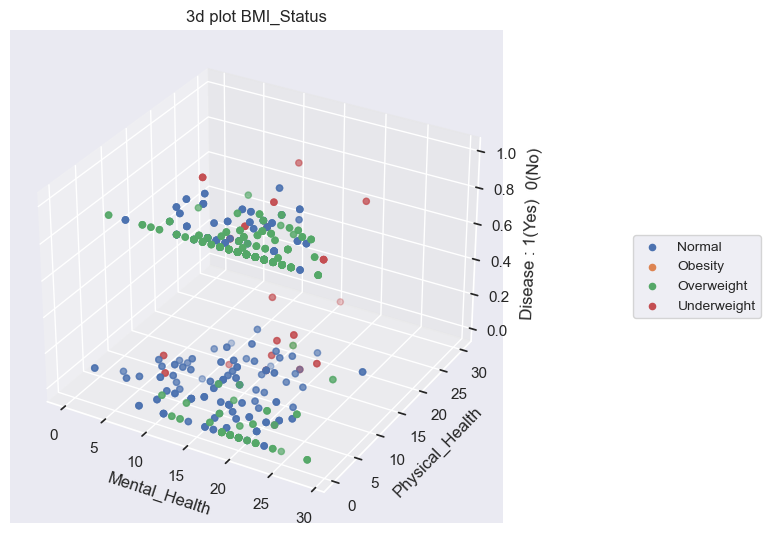

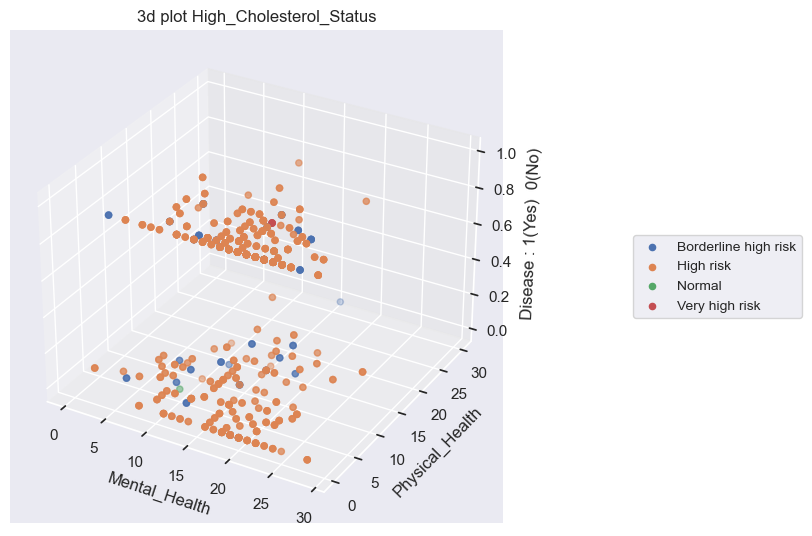

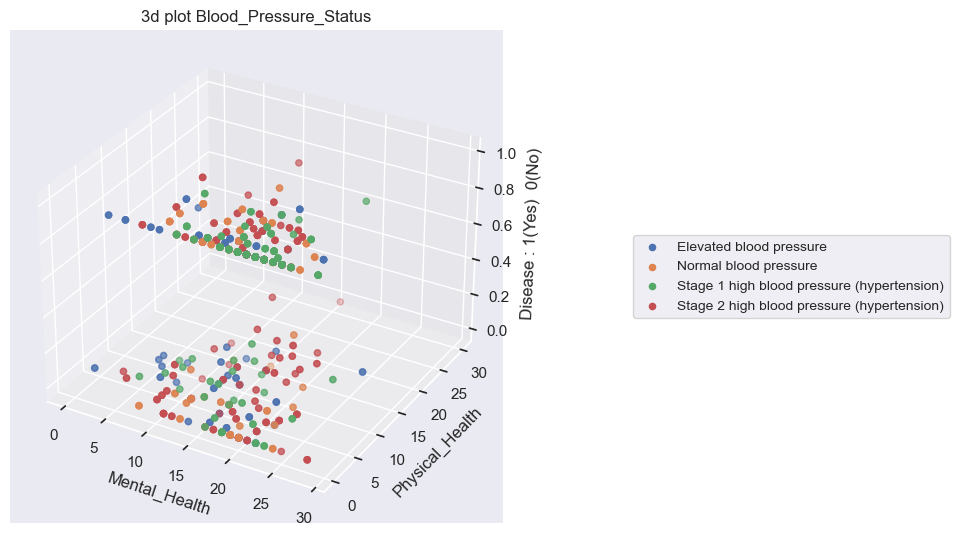

In [52]:
health_status = ['BMI_Status','High_Cholesterol_Status','Blood_Pressure_Status']

multivariate_contvscat2 (df,'Mental_Health','Physical_Health','Disease',health_status)

In [53]:
#### 2.4.5 Summary <a class="anchor" id="section_2_4_5"></a>

##### a) Categorical

* PatientID: The unique identifier of the patient

* Gender: Patient’s gender

* Region: Patient Living Region
* Education: Answer to the question: What is the highest grade or year of school you have?
* Smoking_Habit: Answer to the question: Do you smoke more than 10 cigars daily?
* Drinking_Habit: Answer to the question: What is your behavior concerning alcohol consumption?
* Exercise: Answer to the question: Do you exercise (more than 30 minutes) 3 times per week or more?
* Fruit_Habit: Answer to the question: How many portions of fruits do you consume per day?
* Water_Habit: Answer to the question: How much water do you drink per day?
* Height: Patient’s height
* Weight: Patient’s weight
* High_Cholesterol: Cholesterol value
* Blood_Pressure: Blood Pressure in rest value
* Mental_Health: Answer to the question: During the past 30 days, for about how many days did poor physical or mental health keep you from doing your usual activities, such as self-care, work, or recreation?
* Physical_Health: Answer to the question: Thinking about your physical health, which includes physical illness and injury, for how many days during the past 30 days was your physical health not good to the point where it was difficult to walk?
* Checkup: Answer to the question: How long has it been since you last visited a doctor for a routine Checkup? 
* Diabetes: Answer to the question: (Ever told) you or your direct relatives have diabetes?
* BMI: Measure of body fat based on height and weight that applies to patient


##### b) Continuous


* PatientID: The unique identifier of the patient
* Gender: Patient’s gender
* Age: Patient’s Age
* Region: Patient Living Region
* Education: Answer to the question: What is the highest grade or year of school you have?
* Smoking_Habit: Answer to the question: Do you smoke more than 10 cigars daily?
* Drinking_Habit: Answer to the question: What is your behavior concerning alcohol consumption?
* Exercise: Answer to the question: Do you exercise (more than 30 minutes) 3 times per week or more?
* Fruit_Habit: Answer to the question: How many portions of fruits do you consume per day?
* Water_Habit: Answer to the question: How much water do you drink per day?
* Height: Patient’s height
* Weight: Patient’s weight
* High_Cholesterol: Cholesterol value
* Blood_Pressure: Blood Pressure in rest value
* Mental_Health: Answer to the question: During the past 30 days, for about how many days did poor physical or mental health keep you from doing your usual activities, such as self-care, work, or recreation?
* Physical_Health: Answer to the question: Thinking about your physical health, which includes physical illness and injury, for how many days during the past 30 days was your physical health not good to the point where it was difficult to walk?
* Checkup: Answer to the question: How long has it been since you last visited a doctor for a routine Checkup? 
* Diabetes: Answer to the question: (Ever told) you or your direct relatives have diabetes?
* BMI: Measure of body fat based on height and weight that applies to patient
* Disease: The dependent variable. If the patient has the disease (Disease = 1) or not (Disease = 0)

##### c) Target

* PatientID: The unique identifier of the patient
* Gender: Patient’s gender
* Age: Patient’s Age
* Region: Patient Living Region
* Education: Answer to the question: What is the highest grade or year of school you have?
* Smoking_Habit: Answer to the question: Do you smoke more than 10 cigars daily?
* Drinking_Habit: Answer to the question: What is your behavior concerning alcohol consumption?
* Exercise: Answer to the question: Do you exercise (more than 30 minutes) 3 times per week or more?
* Fruit_Habit: Answer to the question: How many portions of fruits do you consume per day?
* Water_Habit: Answer to the question: How much water do you drink per day?
* Height: Patient’s height
* Weight: Patient’s weight
* High_Cholesterol: Cholesterol value
* Blood_Pressure: Blood Pressure in rest value
* Mental_Health: Answer to the question: During the past 30 days, for about how many days did poor physical or mental health keep you from doing your usual activities, such as self-care, work, or recreation?
* Physical_Health: Answer to the question: Thinking about your physical health, which includes physical illness and injury, for how many days during the past 30 days was your physical health not good to the point where it was difficult to walk?
* Checkup: Answer to the question: How long has it been since you last visited a doctor for a routine Checkup? 
* Diabetes: Answer to the question: (Ever told) you or your direct relatives have diabetes?
* BMI: Measure of body fat based on height and weight that applies to patient
* Disease: The dependent variable. If the patient has the disease (Disease = 1) or not (Disease = 0)

<div class="alert alert-block alert-success">
<a class="anchor" id="chapter3">     

## 3. Preprocessing
</a> 

</div>



### 3.1. Data Cleaning

#### 3.1.1. Identify missing data

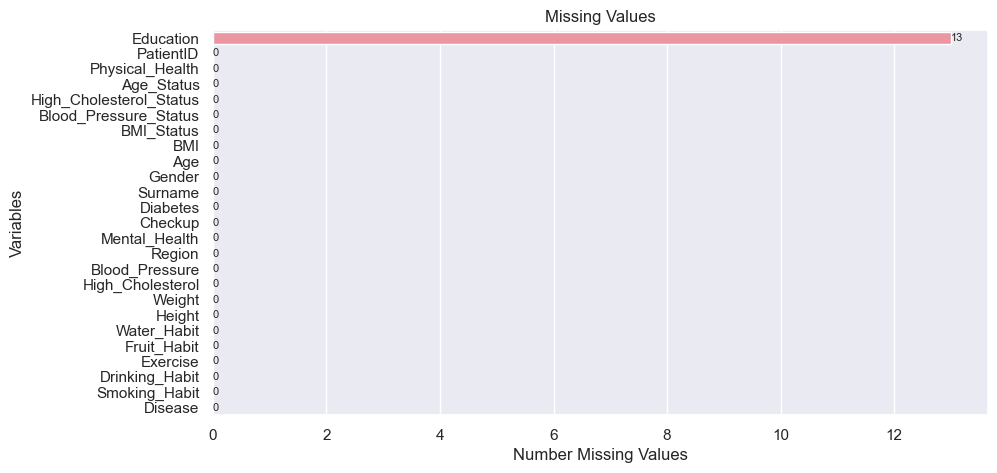

In [55]:
# Check missing values both to numeric features and categorical features

missing_values = df.isnull().sum().sort_values(ascending=False).to_frame().reset_index()

missing_values.rename(columns= {'index':'Variable', 0: 'Number'}, inplace=True)

plt.figure(figsize=(10, 5))
plt.title("Missing Values")
splot=sns.barplot(x="Number",y="Variable",data=missing_values,  orient = 'h')
plt.xlabel("Number Missing Values", size=12)
plt.ylabel("Variables", size=12)
plt.bar_label(splot.containers[0], size=8)
#plt.grid(False)


plt.show()


In [56]:
# Using Mode() function to impute the values using fillna
df['Education']=df['Education'].fillna(df['Education'].mode()[0])
df['Education'].isnull().sum()

0

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
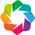

Imported v0.1.58. After importing, execute '%matplotlib inline' to display charts in Jupyter.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Update: verbose=0 displays charts in your local Jupyter notebook.
        verbose=1 additionally provides EDA data cleaning suggestions. It also displays charts.
        verbose=2 does not display charts but saves them in AutoViz_Plots folder in local machine.
        chart_format='bokeh' displays charts in your local Jupyter notebook.
        chart_format='server' displays charts in your browser: one tab for each chart type
        chart_format='html' silently saves interactive HTML files in your local machine


In [57]:
#!pip install autoviz 
from autoviz.AutoViz_Class import AutoViz_Class

In [58]:
# saving the dataframe
df.to_csv('dataframe.csv')

In [59]:
AV = AutoViz_Class()

In [ ]:
df.head(10)

In [ ]:
df_eda = AV.AutoViz('dataframe.csv')

#### 3.1.2. Identifying outliers

In [60]:
df_skewed = pd.DataFrame(columns = ['Variable', 'Nr_Outliers','Outliers','Skewed'])
tmp = pd.DataFrame()

cols = 2
rows = 5
num_cols = df_features.select_dtypes(exclude='object').columns
fig = plt.figure(figsize= (10,9))

outliers =[]

for i, col in enumerate(num_cols):
    
    ax=fig.add_subplot(rows, cols, i+1)
    sns.boxplot(x=df[col], ax=ax)
    
    stat = boxplot_stats(df[col])

    tmp['Variable'] = [col]
    tmp['Nr_Outliers'] = len(stat[0]['fliers'])
    tmp['Outliers'] = [stat[0]['fliers']]
    tmp['Skewed'] = df[col].skew()
    df_skewed = pd.concat([df_skewed,tmp], ignore_index=True)

fig.tight_layout()  
plt.show()

df_skewed

,Variable,Nr_Outliers,Outliers,Skewed
0,Height,0,[],-0.334435
1,Weight,0,[],0.126178
2,High_Cholesterol,11,"[568, 411, 411, 398, 568, 413, 421, 421, 568, 413, 398]",1.167896
3,Blood_Pressure,19,"[200, 178, 178, 178, 180, 178, 180, 180, 180, 172, 174, 200, 192, 178, 192, 180, 192, 174, 200]",0.786838
4,Mental_Health,4,"[0, 0, 0, 0]",-0.512354
5,Physical_Health,25,"[19, 19, 21, 19, 18, 19, 20, 20, 18, 20, 19, 18, 19, 27, 19, 27, 21, 27, 30, 19, 18, 21, 21, 19, 20]",1.345579
6,Age,12,"[163, 163, 158, 141, 167, 163, 155, 153, 152, 156, 158, 162]",4.208812
7,BMI,0,[],-0.136712


In [61]:
def identify_outlier_IQR(datacolumn):    
    Q1,Q3 = np.percentile(datacolumn , [25,75])
    IQR = Q3 - Q1
    lower_limit = Q1 - (1.5 * IQR)
    upper_limit = Q3 + (1.5 * IQR)
    return lower_limit,upper_limit

In [62]:
# Replace by value

def replace_outlier(df, columns, value_lower, value_upper):
    
    for column in columns:
        lower_limit,upper_limit= identify_outlier_IQR (df[column])

        df[column] = np.where(df[column] > upper_limit, value_upper, df[column])
        df[column] = np.where(df[column] < lower_limit, value_lower, df[column])

In [63]:
#Convert Skewed data (positive) to Normal Distribution

print(df['Blood_Pressure'].skew())

df['Blood_Pressure'] = df['Blood_Pressure'].map(lambda i: np.log(i) if i > 0 else 0)

print(df['Blood_Pressure'].skew())


0.7868380309089924
0.33859157862709083


In [ ]:
#Convert Skewed data (positive) to Normal Distribution

print(df['High_Cholesterol'].skew())

df['High_Cholesterol'] = df['High_Cholesterol'].map(lambda i: np.log(i) if i > 0 else 0)

print(df['High_Cholesterol'].skew())

In [64]:
#Convert Skewed data (positive) to Normal Distribution

print(df['Physical_Health'].skew())

df['Physical_Health'] = df['Physical_Health'].map(lambda i: np.log(i) if i > 0 else 0)

print(df['Physical_Health'].skew())

1.3455789673480112
0.29739605469913366


In [65]:
#Age
outliers_columns = ['Age']
value_upper= df['Age'].median()
value_lower = df['Age'].median()
replace_outlier(df, outliers_columns, value_lower, value_upper)

In [66]:
#Mental_Health
outliers_columns = ['Mental_Health','High_Cholesterol','Blood_Pressure']

for col in outliers_columns:
    value_lower, value_upper = identify_outlier_IQR(df[col])

    print((value_lower, value_upper))
    replace_outlier(df, [col], value_lower, value_upper)

(1.0, 33.0)
(114.375, 379.375)
(4.556265723041159, 5.172868442350191)


In [67]:
df_skewed = pd.DataFrame(columns = ['Variable', 'Nr_Outliers','Outliers','Skewed'])
tmp = pd.DataFrame()

cols = 2
rows = 5
num_cols = df_features.select_dtypes(exclude='object').columns
fig = plt.figure(figsize= (10,9))

outliers =[]

for i, col in enumerate(num_cols):
    
    ax=fig.add_subplot(rows, cols, i+1)
    sns.boxplot(x=df[col], ax=ax)
    
    stat = boxplot_stats(df[col])

    tmp['Variable'] = [col]
    tmp['Nr_Outliers'] = len(stat[0]['fliers'])
    tmp['Outliers'] = [stat[0]['fliers']]
    tmp['Skewed'] = df[col].skew()
    df_skewed = pd.concat([df_skewed,tmp], ignore_index=True)

fig.tight_layout()  
plt.show()

df_skewed

,Variable,Nr_Outliers,Outliers,Skewed
0,Height,0,[],-0.334435
1,Weight,0,[],0.126178
2,High_Cholesterol,0,[],0.309939
3,Blood_Pressure,0,[],0.201145
4,Mental_Health,0,[],-0.492052
5,Physical_Health,0,[],0.297396
6,Age,0,[],-0.276310
7,BMI,0,[],-0.136712


#### 3.2.1 Generalization

#### 3.2.2 Normalization

In [72]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 800 entries, 0 to 799
Data columns (total 25 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   PatientID                800 non-null    object 
 1   Region                   800 non-null    object 
 2   Education                800 non-null    object 
 3   Smoking_Habit            800 non-null    object 
 4   Drinking_Habit           800 non-null    object 
 5   Exercise                 800 non-null    object 
 6   Fruit_Habit              800 non-null    object 
 7   Water_Habit              800 non-null    object 
 8   Height                   800 non-null    int64  
 9   Weight                   800 non-null    int64  
 10  High_Cholesterol         800 non-null    float64
 11  Blood_Pressure           800 non-null    float64
 12  Mental_Health            800 non-null    float64
 13  Physical_Health          800 non-null    float64
 14  Checkup                  8

#### 3.2.3 Feature selection

In [ ]:
##### a) Categorical Values

Feature 0: 1.561469
Feature 1: 4.433730
Feature 2: 1.570582
Feature 3: 13.111821
Feature 4: 78.413255
Feature 5: 68.044346
Feature 6: 0.445978
Feature 7: 5.289403
Feature 8: 63.532945
Feature 9: 12.644075
Feature 10: 47.580492
Feature 11: 5.551230
Feature 12: 0.088640
Feature 13: 7.265089


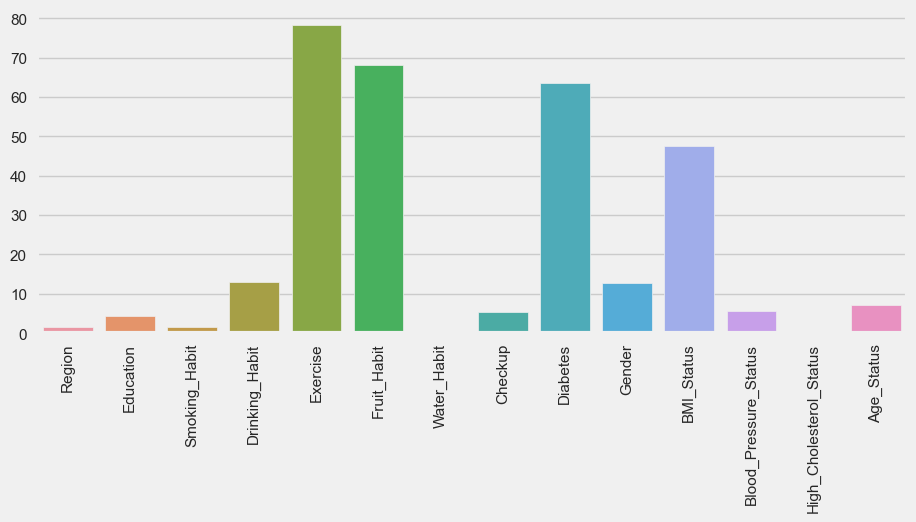

In [78]:
# get categorical data
cat_data = df.select_dtypes(include=['object'])
cat_data.drop(['PatientID','Surname'], axis=1, inplace=True)

# isolate the features and the target values.
X = cat_data.iloc[:, :-1].values
y = cat_data.iloc[:,-1].values

# convert categorical values to numerical representation honoring a specific order
def prepare_inputs(X_train, X_test):
    oe = OrdinalEncoder()
    oe.fit(X_train)
    X_train_enc = oe.transform(X_train)
    X_test_enc = oe.transform(X_test)
    return X_train_enc, X_test_enc

# convert like values into numerical representations
def prepare_targets(y_train, y_test):
    le = LabelEncoder()
    le.fit(y_train)
    y_train_enc = le.transform(y_train)
    y_test_enc = le.transform(y_test)
    return y_train_enc, y_test_enc

# split our data into train and test sets and process the data with the above functions
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=1)
X_train_enc, X_test_enc = prepare_inputs(X_train, X_test)
y_train_enc, y_test_enc = prepare_targets(y_train, y_test)

#select the best features utilizing the Chi-Squared test
def select_features(X_train, y_train, X_test, k_value='all'):
    fs = SelectKBest(score_func=chi2, k=k_value)
    fs.fit(X_train, y_train)
    X_train_fs = fs.transform(X_train)
    X_test_fs = fs.transform(X_test)
    return X_train_fs, X_test_fs, fs

# feature selection
X_train_fs, X_test_fs, fs = select_features(X_train_enc, y_train_enc, X_test_enc)
# what are scores for the features
for i in range(len(fs.scores_)):
    print('Feature %d: %f' % (i, fs.scores_[i]))
    
# what are scores for the features
names = []
values = []
for i in range(len(fs.scores_)):
    names.append(cat_data.columns[i])
    values.append(fs.scores_[i])
chi_list = zip(names, values)

# plot the scores
plt.figure(figsize=(10,4))
sns.barplot(x=names, y=values)
plt.xticks(rotation = 90)
plt.show()

In [ ]:
##### b) Numeric Values

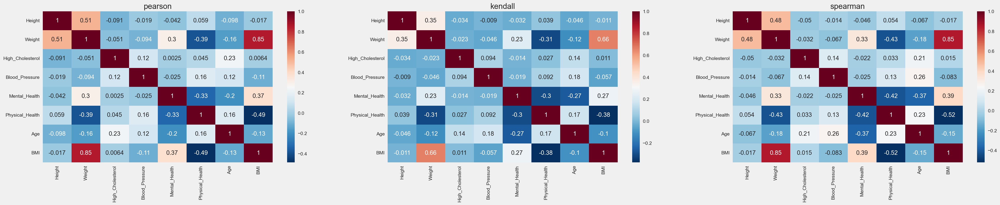

In [79]:
# plotting heatmap using all methods for all numerical variables (peason, kendall, spearman)
plt.figure(figsize=(36,6), dpi=140)
for j,i in enumerate(['pearson','kendall','spearman']):
    plt.subplot(1,3,j+1)
    corrs = df_metricfeatures.corr(method=i)
    sns.heatmap(corrs, cmap='RdBu_r',annot=True)
    plt.title(i, fontsize=18)
plt.show()

In [ ]:
#Menthal_Health Vs BMI and Physical_Health Vs BMI
#Pearson Selection:  Menthal_Health, BMI and Physical_Health


#### 3.2.4 Aggregation

### 3.3. Data Reduction

In [ ]:
# Variable transformation and creation - Strategies:
# Data cube aggregation
# Dimensionality reduction
# Data compression
# Discretization
# Numerosity reduction
# Attribute subset selection

<div class="alert alert-block alert-success">
<a class="anchor" id="chapter4">     

## 4. Modelling
</a> 

</div>




<div class="alert alert-block alert-success">
<a class="anchor" id="chapter5">     

## 5. Assessment
</a> 

</div>

<div class="alert alert-block alert-success">
<a class="anchor" id="chapter6">     

## 6. Conclusion
</a> 

</div>

In [ ]:
x = df
# Import Library for VIF
from statsmodels.stats.outliers_influence import variance_inflation_factor
def calc_vif(x):
# Calculating VIF
vif pd.DataFrame()
vif["variables"] = x. columns
vif["VIF"] = [variance_inflation_factor (x.values, i) for i in range(x.shape [1])]
return(vif)
calc_vif(x)